# ML Auto 14.ipynb

Válaszható lett.

> Itt annyit változtattam, hogy 'Action' után is visszaengedem a before after adatokat. Ennyivel bővülnek a before after adatok. Igy nem csak a mesterséges mozgatás által jut adatokhoz.

Bevezetésre került:

> Kivettem a before after linreg becslésből az Interceptet

Bevezetésre került:

> Linreg helyett MLP van a main modelben


# ToDo
letölteni a pythont és ott futtatni a kódot

huzzon egy nyomot a becslésre is, hogy lássam, hogy hova a faszomba becsüli az első modell
a mit is? ja igen a középtől való eltérést.

csinálni egy második modelt illetve kettőt

az egyik legyen a régi, de hagyjuk a faszba a fel-le becslést, az egész before aftert
és csak egyszerűen kössünk rá a becslésre valamilyen szabályt. Ha nagyobb mint x akkor +3

a másik verzió amit gyorsan ki kéne próbálni, hogy a linreg helyett beteszek egy mlp-t

**ToDo:**

Megnézni, hogy normalizálom-e az adatokat a neruális háló előtt, mert lehet hogy ez viszi félre a becslést.

**Gondolat:**

Nyilvánvaló, hogy egy idő után se a before after adatokra nem képes jó becslést adni
```
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.13709439]]
-------- 1 y up ->  center =  [[1.94404015]]
-------- 1 y up ->  right  =  [[1.85292015]]
```
Ezért arra gondoltam, hogy beeresztem azokat az adatokat is, amelyeket az action körben lép meg.
Ha úgy se megy akkor át kell gondolni a képletet! A becslés képleétt, before after.

A másik, hogy csinálni kéne egy ábrát arra nézve, hogy mi a kapcsolat a tényleges before after között és nem csinálni rá semmilyen becslét.
Egyszerűen minden metrikára megnézni, hogy mi a lépés elötti adata és mi a lépés utáni adata. Ezt meg lehet csinálni úgy, hogy egy ploton vízszintesen van before, fűggőlegesen az after, és színnel van kódolva az action (kék +1, piros -1)

Amúgy most jutott eszembe, hogy egyébként a 0 actionre nem is becsülünk lehet, hogy ez is hiba.

Vagy úgy is lehet ábrázolni, hogy egy ploton van a +1 és külön egy másik ploton a -1. A lényeg, hogy nem becslés, hanem a before after közötti kapcsolat szenzoronként.

A fenti viszgálatot azért végzem el, hogy lássam, hol kap olyan adatokat ** milyen helyzetben kap olyan adatokat ** a before after adatsor amitől ilyen mértékben elromlik az előre jelző képessége.

2. Teljesen nyilvánvaló, hogy a szenzoros adatok és a tengelytől mért távolság közötti kapcsolatot a lineáris regresszió képtelen megragadni.

3. Utána ki kell próbálni, hogy a szenzorok nem előre néznek, hanem oldalra. Igen ez teljes egészében az amit a célváltozó is mér. De csak ellenőrzés végett.



# Micado Auto Scale Research

Ebben a felskálázási adatok elemzésével foglalkozom.

Ez az interkatív bemutató arra van, hogy a válotzók közötti összefüggéseket jobban átlásssam, elemezzem, az esetleges anomáliákat rögtön kiszúrjam.

A playground részben a rendszer alapját adó neuráli háló beállításaival lehet játszani és megfigyelni, hogy milyen hatással van a rendszer teljesítményére.

<a name="tartalom"></a>

## Tartalom

Bevezetés

> [Empty](#empty)<br>
> [Play Ground](#play_ground)<br>
> [SandBox](#sandbox)<br>
> [Before After](#beforeafter)<br>
> [Szintetikus adatok generálása](#szintetikus_adatok)<br>
> [Irodalom](#irodalom)<br>
> [ToDo](#todo)<br>


## Bevezető gondolat

Összességében az egésszel kapcsolatban van egy hatalmas kérdőjel.

Tulajdonképpen két paradigma van.

Az egyik - nem az enyém - így néz ki:

Egyszerűen becsüjük meg azt, hogy az adott szenzoros adatok alapján mi legyen a döntés kimenetele (fel, le, semmi). Akkor hoztunk jó döntést, ha valamilyen metrika alapján valamilyen költséget minimalizáltunk, vagy maximalizáltunk. Például, ha egy döntéssel sikerült közelebb kerülni a záróvonalhoz, vagyis az út közepére. Vagy az az autó a lehető legmeszebb jutott el anélkül, hogy érintette volna a falat és lehetőleg a leggyorsabban is.

A másik - amin én dolgozom - viszont egy plusz lépéssel egészül ki és ettől sokkal bonyolultabb. Hogy van-e létjogosultsága az ennek a kisérletnek a lényege.

Vannak szenzoros adataink, ami alapján hozunk egy döntést. Eddig olyan mint a máisik, de az érdemi különbség a módszerben és a tanulás folyamatában van.

A szenzoros adatokból megbecsüljük azt, hogy mennyire vagyunk jók és nem azt becsüljük, hogy mit kéne tenni!

Ha nem vagyunk jók akkor egy második modell segítségével csinálunk valamilyen lépést, amitől azt várjuk, hogy jók leszünk.

És itt jogosan merül fel a kérdés, hogy de miért nem az első módszert alkalmazzuk és erre most még én sem tudom a választ pontosan megadni. De röviden erről szól ez a kutatás.

## Paradmigva váltás

Miért olyan nehéz debuggolni ezt a rendszert?

Azért mert ha belegondolsz felügyelt tanulásnál mutatsz egy mintát, a rendszer kiszámolja a hibát és a hiba szerint módosítja a tanulásnál a súlyokat.

Itt viszont mutatsz egy mintát a rendszer kiszámoja a hibát a hiba szerint módosítja a súlyokat, a súlyok alapján hoz egy döntést, AMIT VISSZACSATOLÓDIK A RENDSZERBE olyan formán, hogy ezzel a lépéésel megváltoznak a bemeneti adatok, ami alapján újra tanítjuk a rendszert, és így tovább ahogy haladunk előre az időben, a tanulás során.

>> Attól lesz reinforcement learning, hogy a döntést visszatápláljuk a rendszerbe, ezáltal megváltoznak a bemeneti adatok. Ez a legnagyobb különbség a super-vised és a re-enforcement learning között.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import MinMaxScaler

import warnings
warnings.filterwarnings('ignore')

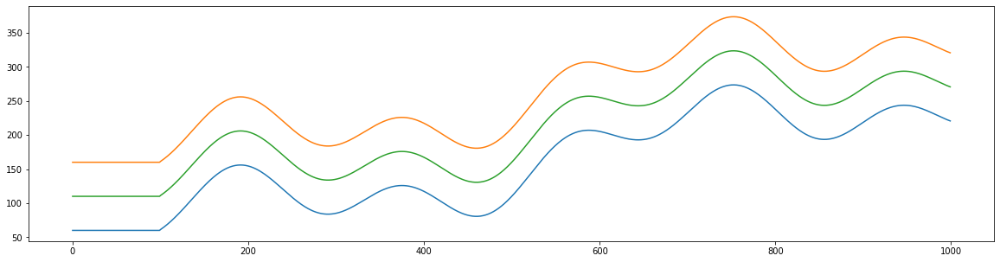

In [2]:
distance    = np.arange(0, 1000, 1)
road        = 100
wall_left   = 30*(np.sin(distance/180)) + distance * 0.3 + 30 * np.cos(distance/30) + 50 * np.sin(distance/90)
wall_left[0:100] = 60
wall_right  = wall_left + road
wall_center = ( wall_left + wall_right ) / 2


plt.figure(figsize=(20,5)); plt.plot(wall_left); plt.plot(wall_right); plt.plot(wall_center); plt.show()

In [3]:
class Road():
  def __init__(self, wide):
    self.distance    = np.arange(0, 3000, 1)
    self.wide        = wide
    self.wall_right  = 30*(np.sin(self.distance/180)) + self.distance * 0.3 + 30 * np.cos(self.distance/30) + 50 * np.sin(self.distance/90)
    self.wall_right[0:100] = 60
    self.wall_left   = self.wall_right + self.wide
    self.wall_center = ( self.wall_left + self.wall_right ) / 2

  def show(self):
    fig, ax = plt.subplots(figsize=(26,10)); ax.set_ylim(40, 1000); ax.plot(self.wall_left); ax.plot(self.wall_right); ax.plot(self.wall_center);
    return fig, ax


In [4]:
class Car():
  def __init__(self, road):
    self.road = road
    self.x = 0
    self.y = self.road.wall_center[0]
    self.sight = 154           # ennyit lát előre 300, 54
    self.sight_center = 150

    self.y_history  = []
    self.x_history  = []
    self.y_center   = []; self.y_center = self.road.wall_center
    self.y_distance = []
    self.y_distance_real = []
    self.y_distance_predicted = []
    self.regression = LinearRegression(fit_intercept=False)
# Bevezetésre került az MLPRegreression
    self.mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                            activation='tanh',
                            solver='adam',
                            batch_size='auto',
                            learning_rate_init=0.01,
                            max_iter=1000,
                            shuffle=False,
                            random_state=1,
                            momentum=0.9,
                            nesterovs_momentum=True,
                            early_stopping=True,
                            n_iter_no_change=1000)
# Bevezetésre került az X MinMaxScaler
    self.x_minmaxscaler = MinMaxScaler(feature_range=(-1,1))
# Bevezetésre került az y MinMaxScaler
    self.y_minmaxscaler = MinMaxScaler(feature_range=(-1,1))
#
#    self.regression_left = LinearRegression()
    self.regression_left = LinearRegression(fit_intercept=False)
#    self.regression_center = LinearRegression()
    self.regression_center = LinearRegression(fit_intercept=False)
#    self.regression_right = LinearRegression()
    self.regression_right = LinearRegression(fit_intercept=False)

# most
    self.sensor_center = []
    self.sensor_left   = []
    self.sensor_right  = []
    self.before  = []
    self.after   = []

    self.mesterseges_coutner = 0


  def calculate_distances(self):
    # ha bármikor kevesebb a faltól mért távolsága bármelyik szenzoron akkor a szenzorokon mért távolság is ennyi lesz
    
    k = self.x; d = 0
    while(k < self.x + self.sight_center):
      k += 1; d += 1
      self.distance_center_from_wall = d
      if(int(self.road.wall_left[k]) < self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break
      if(int(self.road.wall_right[k]) > self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1;  d += 1
      self.distance_left_from_wall = d
      if(int(self.road.wall_left[k]) < self.y + d):
        print('Sensor from left wall = ', self.distance_left_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1; d += 1
      self.distance_right_from_wall = d
      if(int(self.road.wall_right[k]) > self.y - d):
        print('Sensor from right wall = ', self.distance_right_from_wall)
        break

    #ki kell kalkulálni a tényleges távolságot a ball és a jobb faltól
    # mert ezekre fogom tanítani a neurális hálót, ahol ezeket becsüljük
    # és a bemeneti változó a 3 szenzorból érkező adat lesz.
    # valójában azt mérjük, hogy milyen távolságra van az út közepétől

    self.distance_from_top     = abs(self.road.wall_left[self.x] - self.y)
    self.distance_from_bottom  = abs(self.road.wall_right[self.x] - self.y)
    print('most távolsagra van a felső faltól = ', self.distance_from_top)
    print('most távolsagra van az alsó faltól = ', self.distance_from_bottom)


    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')
    print('self.x                       = ', self.x)
    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')

    # mi lenne, ha mégis inkább a kettő hányadosát becsülném (1 ha egyenlő távolságra van)
    # self.vertical_distance_from_middle = self.road.wall_center[self.x] - self.y
    # self.vertical_distance_from_middle = self.distance_from_top / self.distance_from_bottom

    self.vertical_distance_from_middle = self.y - self.road.wall_center[self.x]

    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')
    print('self.vertical_distance_from_middle = ', self.vertical_distance_from_middle)
    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')




    print('ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa = ', self.vertical_distance_from_middle)


    # de elötte szeretnék még valamit leellenőrizni
    # ezeknek a hossza nem fog megeggyezni a tényleges futások számával, hanem több lesz (milyen jó lett volna erre egy teszt esetet írni és akkor test driven development lenne)

    print('\t\t\t ---------------- Teszt ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Teszt End --------------')


  def append(self):
    self.y_distance.append(self.vertical_distance_from_middle)

    self.sensor_left.append(self.distance_left_from_wall)
    self.sensor_center.append(self.distance_center_from_wall)
    self.sensor_right.append(self.distance_right_from_wall)

    print('\t\t\t ---------------- Append ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Append End --------------')


  def run(self):
    for i in range(0, 3000, 1):
      print('# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------')
      _summary_mlp_prediction_was_taken = 0
      _summary_mlp_fit_was_taken = 0
      _summary_mesterseges_mozgatas = 0
      _summary_action_was_taken = 0

      self.x = i
      self.calculate_distances()
      # !!!
      self.append()
      # !!!
      if( i % 1 == 0 ):
        if ( i % 80 == 0 ):
          self.plot()
          print(' --- plot --- ')

      if( i >= 0 ):

        if( i % 3 == 0 and i >= 12 ):

          print('------------------------------ IF i % 3 == 0 ------------------------------')
          print('# i = ', i)
          print('# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)')
          X = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          y = np.array([self.y_distance]).T
          print('X.shape = ', X.shape)
          print('y.shape = ', y.shape)
          # print('X       = ', X)
          # print('y       = ', y)
          print('i       = ', i)
          self.regression.fit(X, y)
          _summary_mlp_fit_was_taken = 1
# Lineáris regresszió helyett Neurális hálót használok
          self.x_minmaxscaler.fit(X)
          self.y_minmaxscaler.fit(y)
          X_scaled = self.x_minmaxscaler.transform(X)
          y_scaled = self.y_minmaxscaler.transform(y)
          print('---------------------')
          print('X.max = ', X.max())
          print('X.min = ', X.min())
          print('X[:,0].max = ', X[:,0].max())
          print('X[:,0].min = ', X[:,0].min())
          print('X[:,1].max = ', X[:,1].max())
          print('X[:,1].min = ', X[:,1].min())
          print('X[:,2].max = ', X[:,2].max())
          print('X[:,2].min = ', X[:,2].min())
          print('y.max = ', y.max())
          print('y.min = ', y.min())
          print('---------------------')
          print('X_scaled.shape = ', X_scaled.shape)
          print('y_scaled.shape = ', y_scaled.shape)
          print('X_scaled.max = ', X_scaled.max())
          print('X_scaled.min = ', X_scaled.min())
          print('X_scaled[:,0].max = ', X_scaled[:,0].max())
          print('X_scaled[:,0].min = ', X_scaled[:,0].min())
          print('X_scaled[:,1].max = ', X_scaled[:,1].max())
          print('X_scaled[:,1].min = ', X_scaled[:,1].min())
          print('X_scaled[:,2].max = ', X_scaled[:,2].max())
          print('X_scaled[:,2].min = ', X_scaled[:,2].min())
          print('y_scaled.max = ', y_scaled.max())
          print('y_scaled.min = ', y_scaled.min())
          print('---------------------')
          self.mlp.fit(X_scaled, y_scaled)


        if( i % 3 == 1 and i >= 22 ):

          print('------------------------------ IF i % 3 == 1 ------------------------------')
          print('# i = ', i)
          print('# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja')
          X_test = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          _X_test = np.array([X_test[-1,:].reshape(-1,1)])
          _X_test = np.array([X_test[-1,:]])
          print('actual _X_test = ', _X_test)
          predicted_test = self.regression.predict(_X_test)
# Lineáris regresszió helyett Neurális hálót használok
          _X_test_scaled = self.x_minmaxscaler.transform(_X_test)
          predicted_test = self.mlp.predict(_X_test_scaled)
# ToDo : Fontos lenne visszatranszformálni a predicted_test értéket mielőtt belekerül az archivumba
          _summary_mlp_prediction_was_taken = 1
          self.y_distance_real.append(self.y_distance[-1])
          self.y_distance_predicted.append(predicted_test)
          print('actual predicted = ', predicted_test)
          # print('actual predicted = {:.5f}'.format(predicted_test[0,0]))
          print('actual self.y_distance[-1] = ', self.y_distance[-1])
#          print('actual self.y_distance     = ', self.y_distance)
          print('len(self.y_distance_real)      = ', len(self.y_distance_real))
          print('len(self.y_distance_predicted) = ', len(self.y_distance_predicted))

          if( i % 32 == 0 ):
            # olyan szar a becslés, hogy az hihetetlen
            plt.figure(figsize=(12, 5)); plt.scatter(self.y_distance_real, self.y_distance_predicted)
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()
            
            # korábban csak azokat az adatokat plottoltam amik a tanulás után lettek visszamérve,
            # de nézzük meg a teljes adatsoron
            X_test_full = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
            _X_test_full = X_test_full
            predicted_test_full = self.regression.predict(_X_test_full)
# Lineáris regresszió helyett Neurális hálót használok
            _X_test_full_scaled = self.x_minmaxscaler.transform(_X_test_full)
            predicted_test_full = self.mlp.predict(_X_test_full_scaled)
# ToDo : itt még lehet, hogy kéne transzformálni y-t is és az egészet visszatranszformálni eredeti értékére + ellenőrizni, hogy tulajdonképpen amikor skálázom az y-t akkor mi alapján skálázok
            predicted_test_full = self.y_minmaxscaler.inverse_transform(predicted_test_full.reshape(-1, 1))
            _y_test_full = np.array([self.y_distance]).T
            print(_y_test_full.shape)
            print(predicted_test_full.shape)
            plt.figure(figsize=(12, 5)); plt.scatter(_y_test_full, predicted_test_full, c='r');
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()

            _array_target = np.array([_y_test_full.ravel(), predicted_test_full.ravel(), np.arange(0, _y_test_full.shape[0], 1)]).T

            plt.figure(figsize=(12, 5)); plt.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2]);
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()

            plt.figure(figsize=(12, 5)); ax = plt.axes(); ax.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2])
            ax.plot([-10, 2, 4, 10], [-10, 2, 4, 10]); ax.set_ylabel('y_distance_predicted'); ax.set_xlabel('y_distance_real'); plt.show()
            print(' --- plot predcition --- ')


        # most jön az, hogy véletlenszerűen kell egyet ugrania fel, vagy le
        # ez felel meg a before after dologonak
        # az így létrejött adatokat is el kell tárolni úgy mint
        # mi volt a szezoros adat before
        # mi lett a szenzoros adat after
        # mi volt az y before, mi lett az y after
        # mivel mindíg egyet fogunk csak lépni, ezért a dif mindíg egy lesz
        # de ezt számítani kell, mivel a későbbiek folyamán lehet, hogy többet is fog lépni

        if( i % 3 == 2 ):

          print('------------------------------ IF i % 3 == 2 ------------------------------')
          print('# i = ', i)
          print('# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok')

          _summary_mesterseges_mozgatas = 1
          
          if( self.mesterseges_coutner == 0 ):                             # Első lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 1

          elif( self.mesterseges_coutner == 1 ):                           # Második lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 2

          elif( self.mesterseges_coutner == 2 ):                           # Harmadik lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 3

          elif( self.mesterseges_coutner == 3 ):                           # Negyedik lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 0

          else:
            print('semmi\n\n\n\n')

          print('self.y = ', self.y)



# itt van egy érdekesség amit csak magamnak írok fel
# ezen a ponton lépünk ki a három if ágból - if( i % 3 == _ )

# ez azért fontos, mert ami itt következik az mindíg lefut
# akár volt neurális háló tanítás
# akár volt neurális háló predikció visszamérése
# akár volt mesterséges mozgatás


# felmerül a kérdés de csak felmerül, hogy nem lehet-e az, hogy ezt csak akkor kéne elvégezni amikor nincs neurális háló tanítás és nincs mesterséges mozgatás sem
# ezt csak egy kísérlet ereéig ki kéne próbálni (if i % 3 == 1) -> vagyis amikor az nn predikció mérése történik

        action = 0
        if( i % 3 == 0 ):

          if( len(self.before) > 9 ):           # ha már van néhány before after adatunk, akkor

            print('------------------------------ IF len(self.before) > 9 ------------------------------')
            print('\n')
            print('# i = ', i)
            print('  Ha már van elég before after adatunk')
            print('# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára')
            # minden egyes szezor adatára el kell készítenünk azt a lineráis regressziós modelt ami megmondja, hogy mi lenne a szenzor értéke, ha 1, 2, 3, ... n lépéssel elvinnénk a kocsit

            # oké megvan a before és megvan az after (self.y, left, center, right)
            before_array = np.array(self.before)
            after_array  = np.array(self.after)
            y_delta = after_array[:,0] - before_array[:,0]
            delta_array = after_array - before_array
#            print('--------------------------------------')
#            print(y_delta)
#            print(before_array.shape)
#            print(after_array.shape)
#            print('self.before = \n', self.before)
#            print('self.after  = \n', self.after)
            print('delta_array = \n', delta_array)
#            print('--------------------------------------')

            # képlet szerint senzor' = w0 + w1 * senzor + w2 * delta_y
            # valójában ez a képlet nem jó és nem így kéne számolni, mert ez figyelembe veszi a szenzor aktuális értékét is, de most így hagyom
            # ------- fenti sort nem tudom miért írtam, hogy baj az ha figyelembe veszük az aktuális értéket is, hm.

            print('# Linear Regression Learning --------------------------------------------------------------------------------------')
            print('\t\t # Linear Regression Training Results -------------------------------------------------------------------------')

            _X_left = np.array([before_array[:,1], delta_array[:,0]]).T # left és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_left = delta_array[:,1].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_left = after = after_array[:,1].reshape(-1, 1)
#            regression_left = LinearRegression()
            regression_left = self.regression_left
            regression_left.fit(_X_left, _y_left)
            # print('\t\t _X_left = \n', _X_left)
            # print('\t\t _y_left = \n', _y_left)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_left.coef_ = ', regression_left.coef_)
            print('\t\t regression_left.intercept_ = ', regression_left.intercept_)
            _predicted_left = regression_left.predict(_X_left)
#            plt.scatter(_y_left, _predicted_left)
#            plt.ylabel('_predicted_left')
#            plt.xlabel('_true_y_left')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,1], after_array[:,1], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()

            _X_center = np.array([before_array[:,2], delta_array[:,0]]).T # center és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_center = delta_array[:,2].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_center = after_array[:,2].reshape(-1, 1)
#            regression_center = LinearRegression()
            regression_center = self.regression_center
            regression_center.fit(_X_center, _y_center)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_center.coef_ = ', regression_center.coef_)
            print('\t\t regression_center.intercept_', regression_center.intercept_)
            _predicted_center = regression_center.predict(_X_center)
#            plt.scatter(_y_center, _predicted_center)
#            plt.ylabel('_predicted_center')
#            plt.xlabel('_true_y_center')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,2], after_array[:,2], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()

            _X_right = np.array([before_array[:,3], delta_array[:,0]]).T # right és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_right = delta_array[:,3].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_right = after_array[:,3].reshape(-1, 1)
#            regression_right = LinearRegression()
            regression_right = self.regression_right
            regression_right.fit(_X_right, _y_right)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_right.coef_ = ', regression_right.coef_)
            print('\t\t regression_right.intercept_ = ', regression_right.intercept_)
            _predicted_right = regression_right.predict(_X_right)
#            plt.scatter(_y_right, _predicted_right)
#            plt.ylabel('_predicted_right')
#            plt.xlabel('_true_y_right')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,3], after_array[:,3], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()


            # most ki kell számolni, hogy mennyi lenne a szenzorok értéke, ha fel le lépkednénk

            # mondjuk maximalizáljuk a fel le lépkedés mértékét 5-ben

            move = np.array([-5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5])

            move = np.array([-2, -1, 0, 1, 2])

            move = np.array([-3, -2, -1, 0, 1, 2, 3])

  # most


            print('\t # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------')

            print('\t\t # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke')
            proba_X_metrika   = np.array([1,1]).reshape(1, -1)
            print('proba_X_metrika   = ', proba_X_metrika)
            predicted_proba_left = regression_left.predict(proba_X_metrika)
            predicted_proba_center = regression_center.predict(proba_X_metrika)
            predicted_proba_right = regression_right.predict(proba_X_metrika)
            print('-------- 1 y up ->  left   = ', predicted_proba_left)
            print('-------- 1 y up ->  center = ', predicted_proba_center)
            print('-------- 1 y up ->  right  = ', predicted_proba_right)
            print('\n')

            # EGY KURVA NAGY ELMÉLETI DILLEMMÁHOZ ÉRKEZTEM.

            # HÁROM MEGOLDÁS VAN

            # EBBŐL SZERINTEM MOST A LEGROSSZABBAT VÁLASZOTTAM

            # 1, MINDENKÉPPEN VÁLASZT EGYET, A LEGJOBBAT

            # 2, CSAK AKKOR MODOSÍT HA KÖZELEBB TUDJA VINNI A KÖZÉPPONTHOZ MINT AHOL MOST VAN
            
            action = 0; tmp = 999999990

            for j in move:
              print('\n')
              print('\t\t minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba')
              print('\t\t j = ', j)
              # ide be kell helyettesítenem az éppen aktuális értéket, olyan mintha egy új X változót csinálnék amiben csak egy sor van és arra kérnék egy becslést a korábbi modell alapján
              # a bement az éppen aktuális szenzoros érték és az új lépés

              # na majd ezt a bemenetet kell ellenőrizni, hogy stimmel-e a tanítás során használt bemenettel
              _X_left   = np.array([[self.distance_left_from_wall, j]])
              _X_center = np.array([[self.distance_center_from_wall, j]])
              _X_right  = np.array([[self.distance_right_from_wall, j]])

              print('\t\t ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------')
              print('\t\t _X_left   = ', _X_left)
              print('\t\t _X_center = ', _X_center)
              print('\t\t _X_right  = ', _X_right)

              # a fenti értékek valószínűleg jók, de mindíg minden lépésnél ellenőrizni kell

              predicted_left   = regression_left.predict(_X_left)
              predicted_center = regression_center.predict(_X_center)
              predicted_right  = regression_right.predict(_X_right)

              print('\t\t predicted_left   = ', predicted_left)
              print('\t\t predicted_center = ', predicted_center)
              print('\t\t predicted_right  = ', predicted_right)

              print('\t\t --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------')
              print('\t\t regression_left.coef_   = ', regression_left.coef_)
              print('\t\t regression_center.coef_ = ', regression_center.coef_)
              print('\t\t regression_right.coef_  = ', regression_right.coef_)
              print('\t\t regression_left.intercept_   = ', regression_left.intercept_)
              print('\t\t regression_center.intercept_ = ', regression_center.intercept_)
              print('\t\t regression_right.intercept_  = ', regression_right.intercept_)

              # nekünk majd azt az értéket kell választanunk amelyik segítségével a legközelebb jutunk a 1 értékhez

              _X = np.array([predicted_left.ravel(), predicted_center.ravel(), predicted_right.ravel()]).T    # figyelni kell rá, hogy eredetileg is ez volt-e a változók sorrendje

              print('\t\t # Ez lesz a bemenete a neurális hálónak')
              print('\t\t -------------------------X-------------------------')
              print('\t\t ', _X)
              print('\t\t ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------')

              predicted_position = self.regression.predict(_X)
              print('\t\t predicted_position linreg model            = ', predicted_position)
# Lineáris regresszió helyett Neurális hálót használok
# Lehet, hogy itt fit_transform használata lenne a helyes!!!!!!!!!!!!!!!!!!!!!!!!
              _X_scaled = self.x_minmaxscaler.transform(_X)
              predicted_position_scaled = self.mlp.predict(_X_scaled)
              print('\t\t predicted_position neural net model scaled = ', predicted_position_scaled)
# Vissza kell transzformálnom eredeti formájába
              predicted_position = self.y_minmaxscaler.inverse_transform(predicted_position_scaled.reshape(-1, 1))
              print('\t\t predicted_position neural net model inverz = ', predicted_position)

              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')

              # legyünk bátrak és módosítsuk az autó self.y pozicióját

              # azzal az értékkel amely abszolút értékben a legkissebb, helyett
              # mivel a célváltozónk akkor jó ha 1. mivel a felső/alsótól mért távolság hányadosa
              # ezért itt azt az értéket kell kiválasztani ami a legközelebb van +1-hez (és nem azt amelyik 0-hoz)

              # természetesen ezen változtatni kell ha ismét az középvonaltól való eltérés mértékét akarjuk becsülni
              # de ahhoz fenti is át kell állítani az adatokat

              if( abs(0 - predicted_position) < tmp):       # rossz - javítva - tesztelés alatt
                action = j
                tmp = abs(0 - predicted_position)
                print('\t\t ---------------------')
                print('\t\t  action = ', action)
                print('\t\t  predicted_position = ', predicted_position)
                print('\t\t  distance from 0 (tmp)= ', tmp)
                print('\t\t ---------------------')

              print('\t\t adott j-re {0} kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------'.format(j))
              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')
            
            print('\t minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------\n')

# igazság szerint ez a kör ahogy mondtam minden lépésben lefut ha már van elég before after adatunk


# a döntés azonban csak akkor fut le ha az alábbi feltétel teljesül

          if( i % 3 == 0 ):                                                       # ugyan ez a feltétel amikor tanítom az út közepének a becslésére
            print('------------------------------ IF i % 3 == 0 ------------------------------')
            _summary_action_was_taken = 1
            print('=================== TAKE ACTION ===================')
# ez lett új az ML Auto 10.ipynb-hoz képest
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            print('-------- ennyivel módosítom self.y értékét --------')
            print('self.y régi értéke = ', self.y)
            self.y = self.y + action
# ez lett új az ML Auto 10.ipynb-hoz képest
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))

            print('self.y új értéke   = ', self.y)
            print('action             = ', action)
            print('----------------- módosítás vége -----------------')




          # újra kell gondolni az egészet, ugyanis akkor is ki kell számolni a before after értéket amikor modosítom a pozicióját,
          # vagyis végig kell gondolni ezt az egészet.
          # az első elképzelésem az volt, hogy a poziciót csak bizonyos esetben modosíthatom, csak akkor amikor nincs tanítás, és nincs szimulált emelés, vagy csökkentés sem
          # utóbbit az if( i % 3 == 2) feltétellel szűrtem


      # adjuk hozzá az értéket a self.y_history-hoz
      print('# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------')
      print('#   itt adom hozzás a self.y a self.y_history-hoz')
      self.y_history.append(self.y)
      print('#    self.y :')
      print(self.y)
#      print('#   self.y_history after append :')
#      print(self.y_history)
      print('# \t\t ----------------- Summary -----------------')
      print('# \t\t\t _summary_mlp_fit_was_taken         = ', _summary_mlp_fit_was_taken)
      print('# \t\t\t _summary_mlp_prediction_was_taken  = ', _summary_mlp_prediction_was_taken)
      print('# \t\t\t _summary_mesterseges_mozgatas      = ', _summary_mesterseges_mozgatas)
      print('# \t\t\t _summary_action_were_taken         = ', _summary_action_was_taken)
      print('# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++')
          



  def plot(self):
    fig, ax = self.road.show()
    circle = plt.Circle((self.x, self.y), 5, color='black')
    ax.add_patch(circle)
    ax.plot(range(int(self.x), int(self.x+self.distance_center_from_wall)), np.repeat(self.y, self.distance_center_from_wall))
    ax.plot(range(int(self.x), int(self.x+self.distance_left_from_wall)), range(int(self.y), int(self.y+self.distance_left_from_wall)))
    ax.plot(range(int(self.x), int(self.x+self.distance_right_from_wall)), range(int(self.y), int(self.y-self.distance_right_from_wall), -1))
    if( len(self.y_history) > 0 ):
      ax.plot(self.y_history)
    plt.show()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


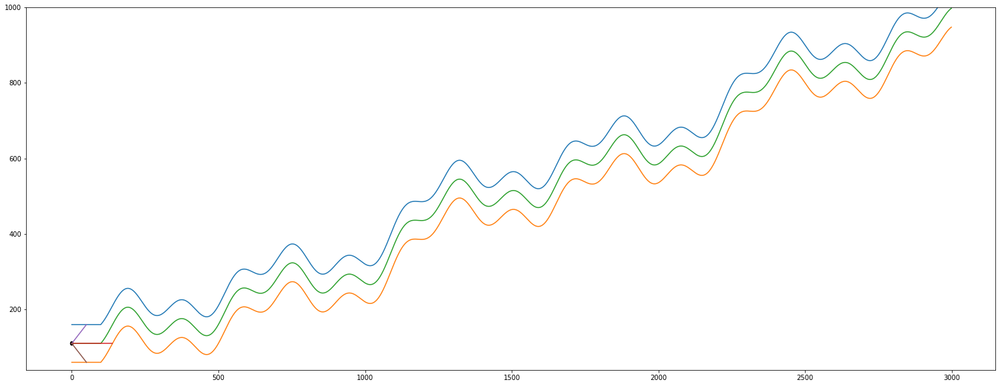

In [5]:
road = Road(wide = 100)
auto = Car(road)

auto.calculate_distances()
auto.plot()

In [6]:
auto.calculate_distances()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------
			 ---------------- 

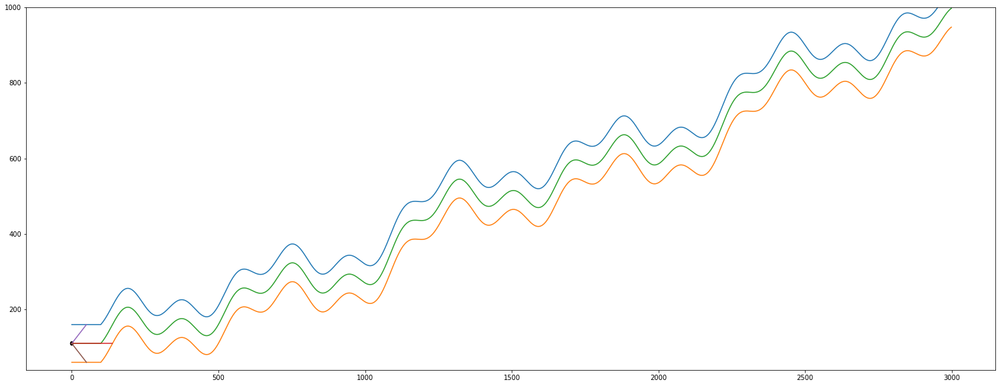

Streaming output truncated to the last 5000 lines.
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[0.99994106 0.82315499]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 54.         104.34744276  48.        ]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-3.]]
		 predicted_position neural net model scaled =  [-1.80899651]
		 predicted_position neural net model inverz =  [[-2.21349476]]
		 -------------------------------------------------------------------------------------------------------------------------------------

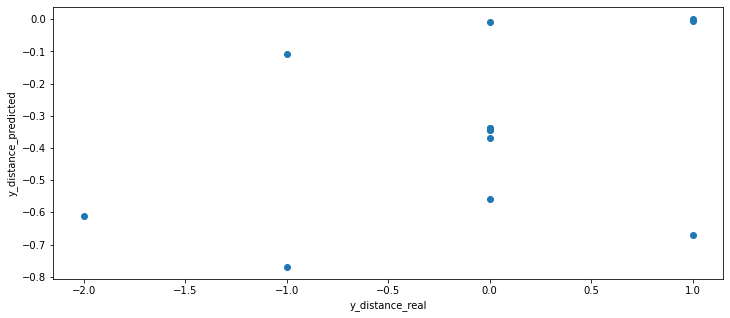

(65, 1)
(65, 1)


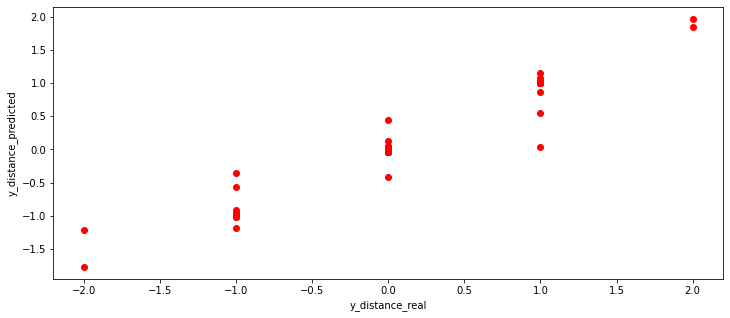

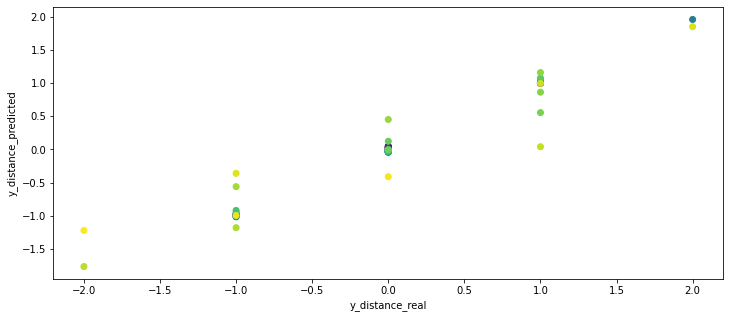

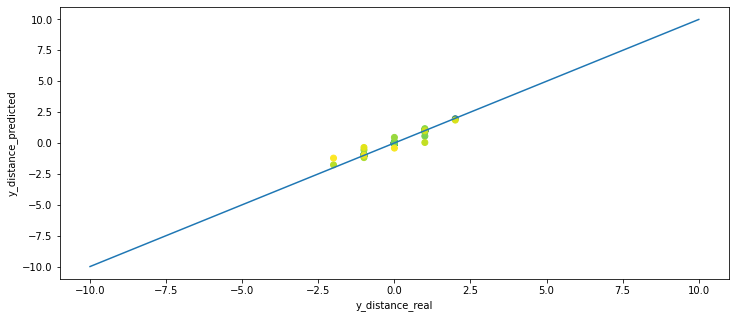

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
108.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  74
Sensor from left wall =  143
Sensor from right wall =  42
most távolsagra van a felső faltól =  52.0
most távolsagra van az alsó faltól =  48.0
cccccccccccccccccccccccccccccc

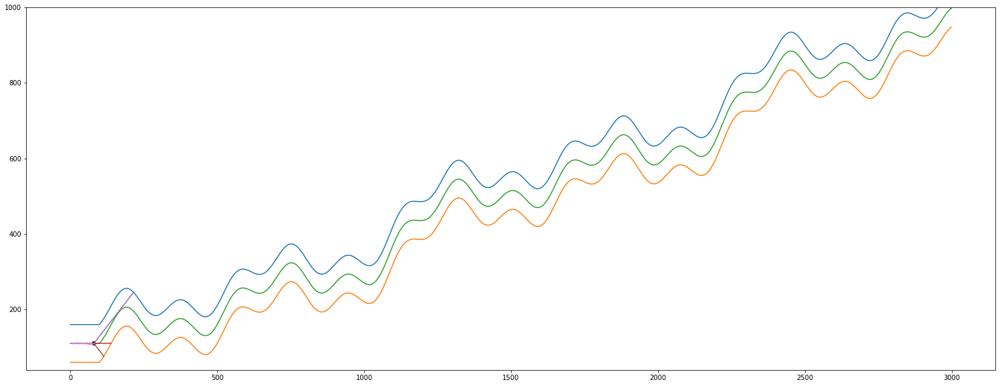

Streaming output truncated to the last 5000 lines.
			 ---------------- Append ----------------
			 len(self.y_distance)    =  134
			 len(self.sensor_left)   =  134
			 len(self.sensor_center) =  134
			 len(self.sensor_right)  =  134
			 self.x                  =  133
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  133
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[95 30 16]]
actual predicted =  [-0.85394053]
actual self.y_distance[-1] =  -12.624415412463293
len(self.y_distance_real)      =  38
len(self.y_distance_predicted) =  38
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
139.0
# 		 ----------------- Summary -------

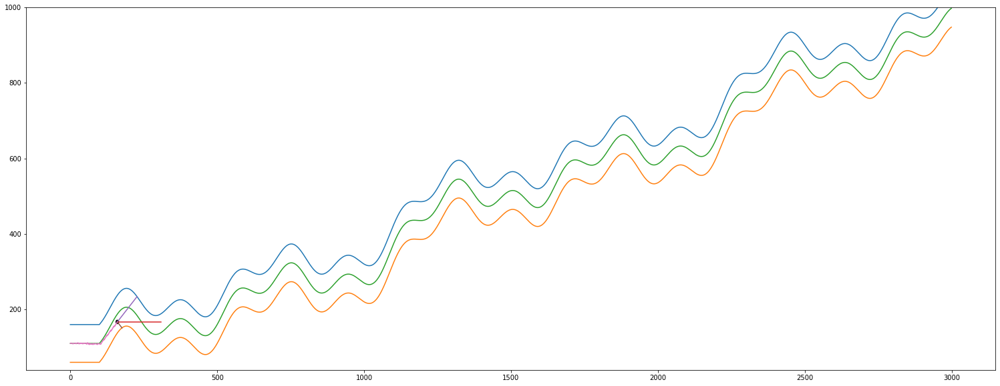

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  160
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 68 150  17]]
actual predicted =  [-0.91026306]
actual self.y_distance[-1] =  -20.678047558086774
len(self.y_distance_real)      =  47
len(self.y_distance_predicted) =  47


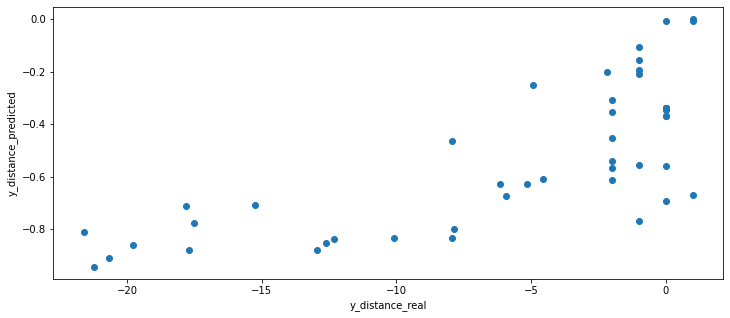

(161, 1)
(161, 1)


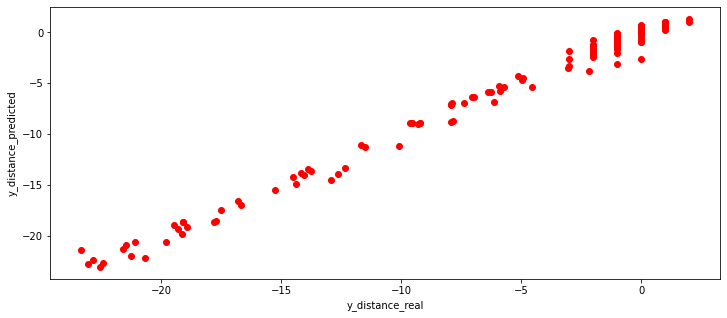

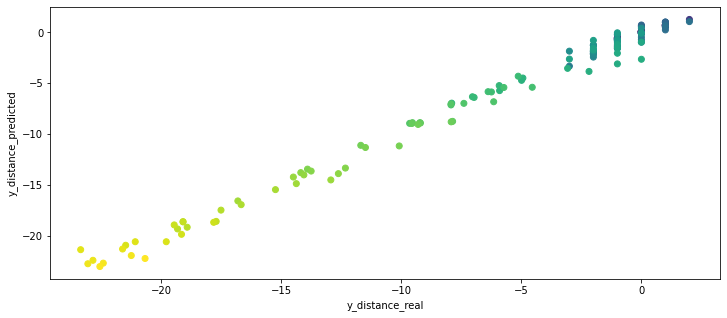

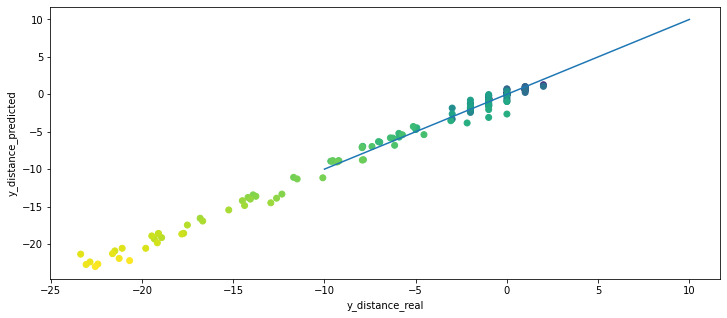

Streaming output truncated to the last 5000 lines.
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-7.63563201]]
		 predicted_position neural net model scaled =  [0.27807151]
		 predicted_position neural net model inverz =  [[-10.2290803]]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re -2 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -1
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  

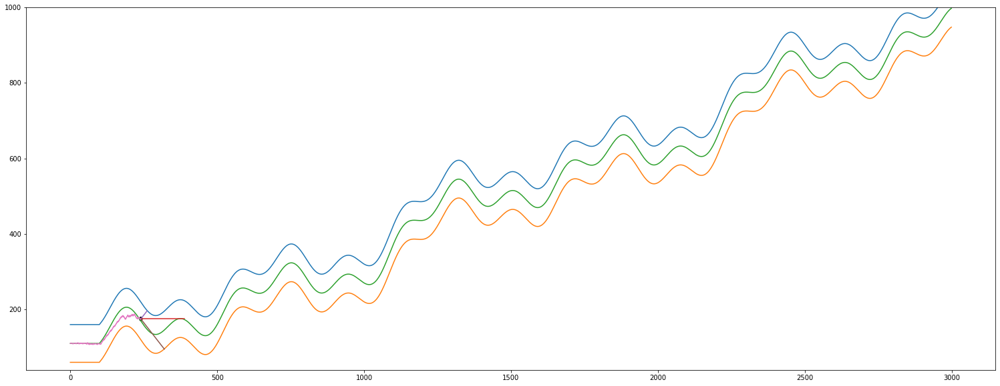

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  240
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (241, 3)
y.shape =  (241, 1)
i       =  240
---------------------
X.max =  150
X.min =  14
X[:,0].max =  146
X[:,0].min =  22
X[:,1].max =  150
X[:,1].min =  27
X[:,2].max =  102
X[:,2].min =  14
y.max =  5.34323264156842
y.min =  -31.878924191766657
---------------------
X_scaled.shape =  (241, 3)
y_scaled.shape =  (241, 1)
X_scaled.max =  1.0000000000000004
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  1.0000000000000004
X_scaled[:,1].min =  -0.9999999999999999
X_scaled[:,2].max =  1.0000000000000002
X_scaled[:,2].min =  -1.0
y_scaled.max =  0.9999999999999999
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  240
  Ha 

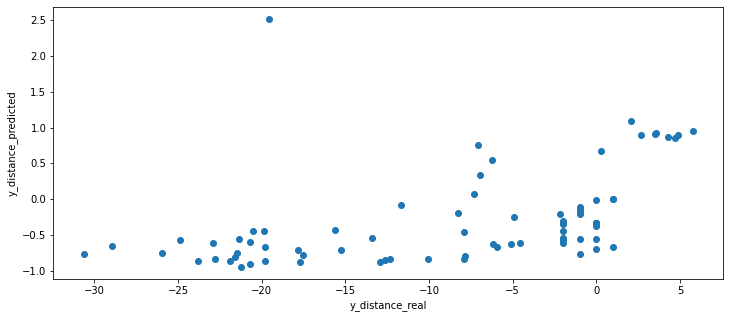

(257, 1)
(257, 1)


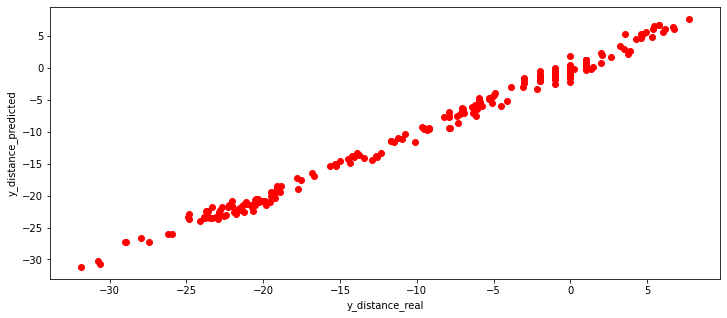

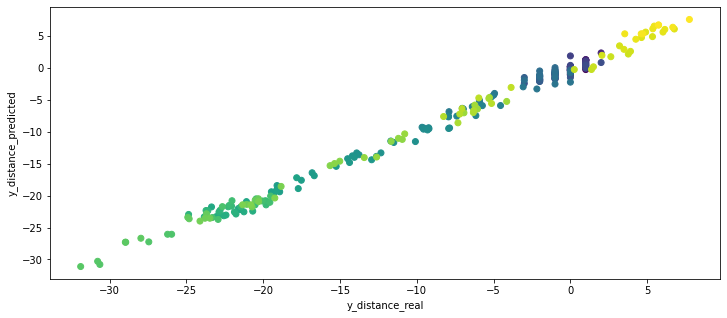

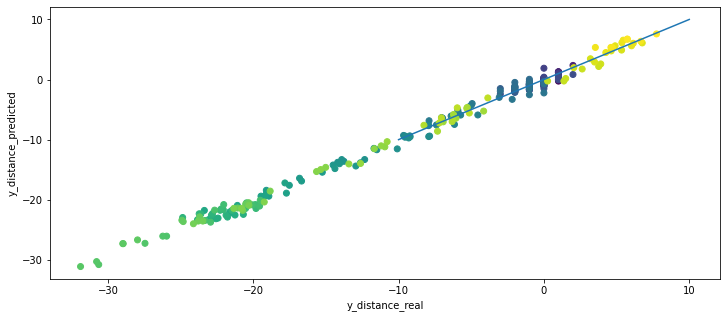

Streaming output truncated to the last 5000 lines.
 [  -1.    0.    3.   -1.]
 [  -3.    1.   83.   -2.]
 [   1.   -1.  -77.    1.]
 [   3.   -1.  -11.    2.]
 [   1.    0.   -2.    0.]
 [  -3.    2.    8.   -2.]
 [  -1.    0.    5.    0.]
 [  -3.    1.   84.   -1.]
 [  -1.    1.    0.   -1.]
 [  -3.    2.    0.   -2.]
 [   1.   -1.    0.    1.]
 [  -3.    1.    0.   -1.]
 [   1.    0.    0.    0.]
 [   3.   -1.    0.    2.]
 [  -1.    0.    0.   -1.]
 [   0.    0.    0.    0.]
 [  -1.    0.    0.    0.]
 [  -3.    1.    0.   -2.]
 [   1.    0.    0.    0.]
 [  -3.    2.    0.   -2.]
 [   1.    0.    0.    1.]
 [  -3.    2.    0.   -1.]
 [  -1.    1.    0.   -1.]
 [  -3.    2.    0.   -2.]
 [  -1.    1.    0.    0.]
 [  -3.    2.    0.   -2.]
 [   1.   -1.    0.    0.]
 [  -3.    2.    0.   -2.]
 [   1.    0.    0.    1.]
 [  -3.    3.    0.   -1.]
 [  -1.    1.    0.   -1.]
 [  -3.    2.    0.   -2.]
 [  -1.    1.    0.    0.]
 [  -3.    4.    0.   -2.]
 [   1.   -1.    0.    0.]
 [  

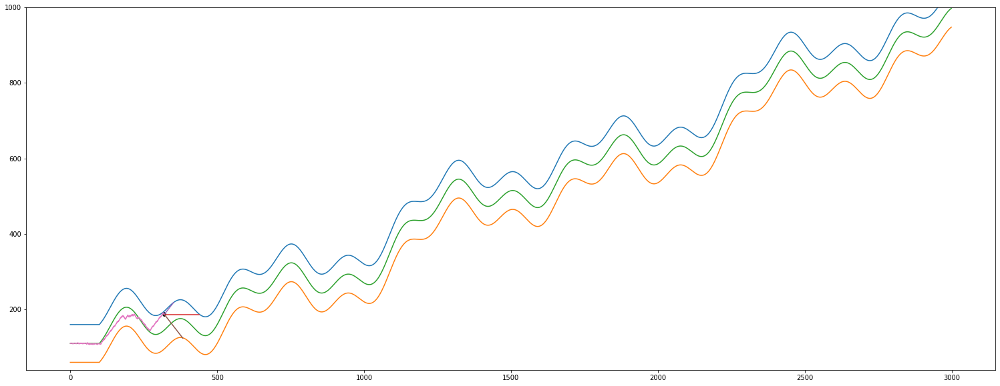

Streaming output truncated to the last 5000 lines.
 [   1.   -1.    0.    1.]
 [   3.   -2.    0.    2.]
 [  -1.    1.    0.    0.]
 [   3.   -1.    0.    2.]
 [  -1.    0.    0.   -1.]
 [   3.   -2.    0.    2.]
 [   1.    0.    0.    0.]
 [   3.   -1.    0.    3.]
 [   1.   -1.    0.    1.]
 [   3.   -2.    0.    3.]
 [  -1.    1.    0.   -1.]
 [   3.   -1.    0.    5.]
 [  -1.    0.    0.   -2.]
 [   3.   -2.    0.   11.]
 [   1.    0.  -41.    2.]
 [  -3.    1.   42.   -5.]
 [   1.    0.    0.    1.]
 [  -3.    2.    0.   -5.]
 [  -1.    0.    0.   -1.]
 [  -3.    1.    0.   -5.]
 [  -1.    1.    0.   -2.]
 [   3.   -1.    0.    4.]
 [   1.   -1.    0.    1.]
 [   3.   -2.    0.    4.]
 [   1.    0.    0.    1.]
 [   3.   -1.  -62.    2.]
 [  -1.    0.    5.   -1.]
 [  -3.    1.   60.   -3.]
 [  -1.    0.    0.   -1.]
 [   3.   -2.    0.    2.]
 [   1.    0.  -65.    1.]
 [  -3.    2.   66.   -2.]
 [   1.   -1.    0.    0.]
 [   3.   -2.  -74.    2.]
 [  -1.    1.    5.   -1.]
 [  

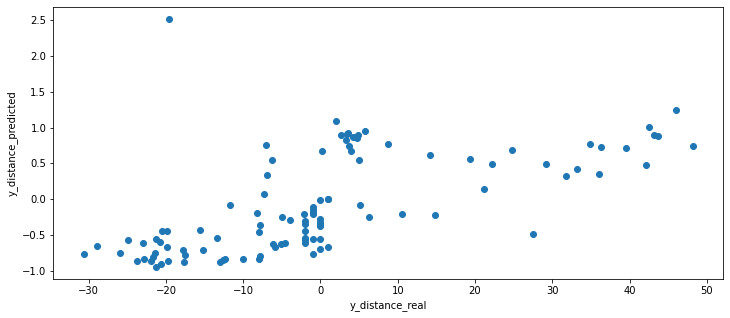

(353, 1)
(353, 1)


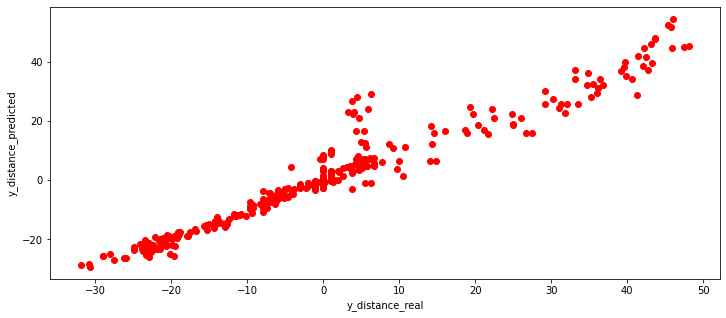

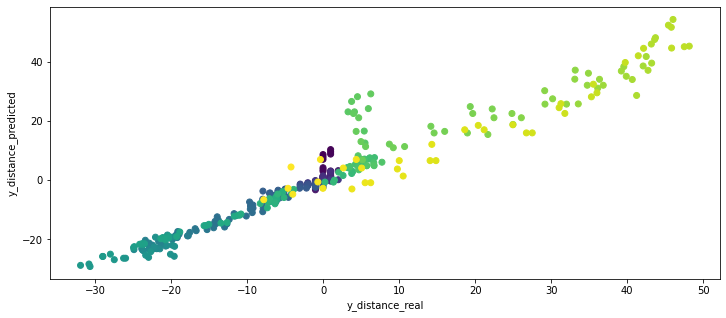

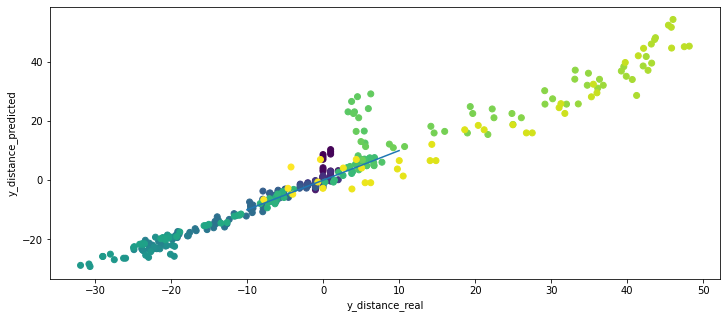

Streaming output truncated to the last 5000 lines.
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  370
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 45 150  82]]
actual predicted =  [-0.53142806]
actual self.y_distance[-1] =  -13.502029288038386
len(self.y_distance_real)      =  117
len(self.y_distance_predicted) =  117
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
162.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége 

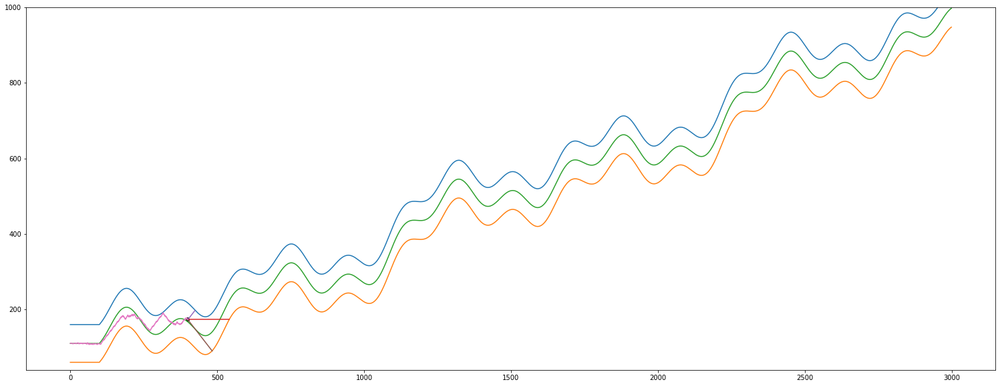

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  7.008610896117432
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  415
			 len(self.sensor_left)   =  415
			 len(self.sensor_center) =  415
			 len(self.sensor_right)  =  415
			 self.x                  =  415
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  416
			 len(self.sensor_left)   =  416
			 len(self.sensor_center) =  416
			 len(self.sensor_right)  =  416
			 self.x                  =  415
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  415
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 25 120  71]]
a

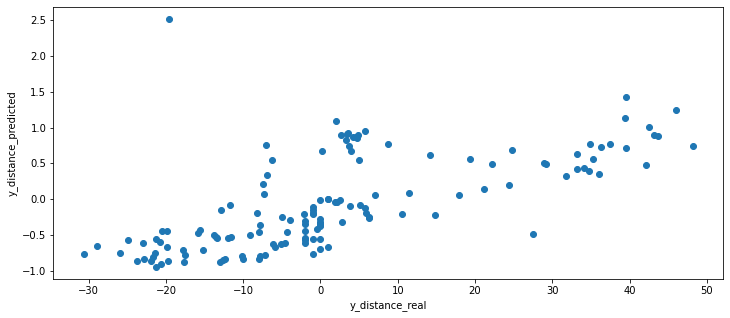

(449, 1)
(449, 1)


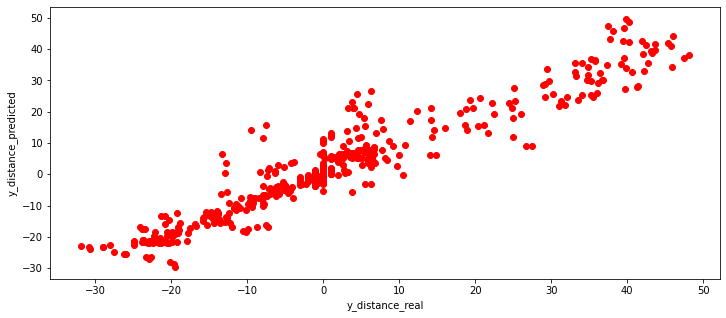

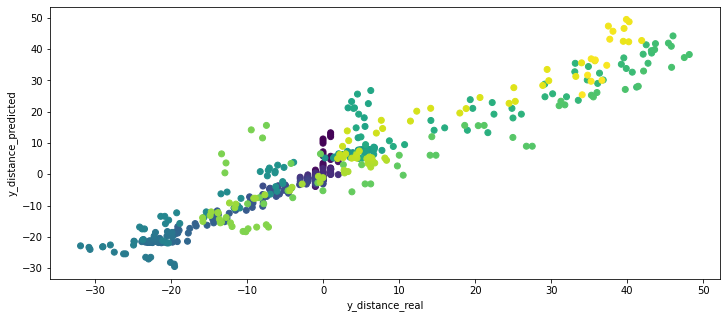

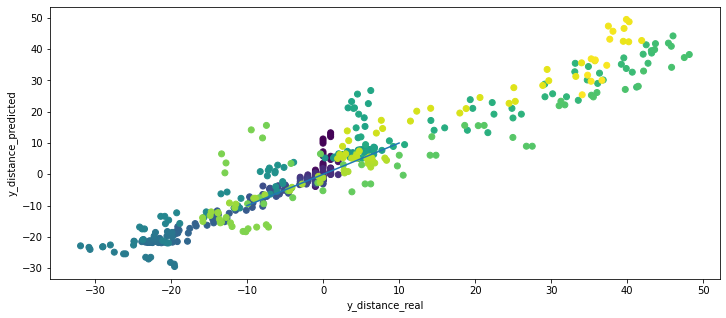

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
167.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  89
Sensor from left wall =  14
Sensor from right wall =  54
most távolsagra van a felső faltól =  15.558759851533296
most távolsagra van az alsó faltól =  84.44124014846669
cccc

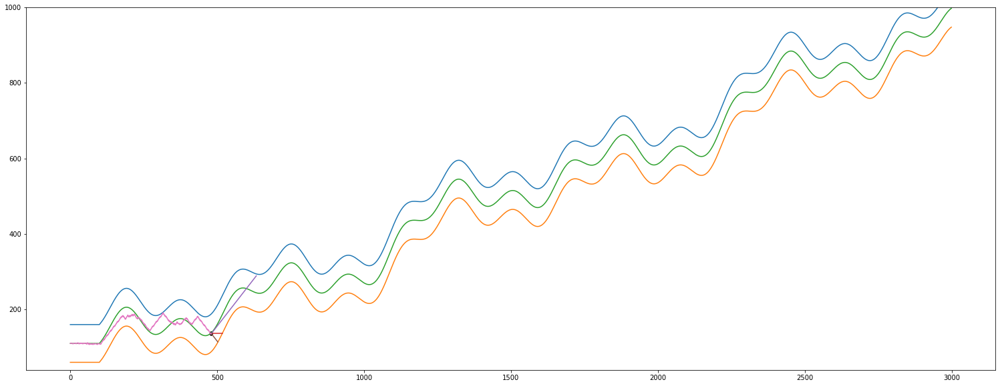

Streaming output truncated to the last 5000 lines.
#    self.y :
160.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  21
Sensor from left wall =  133
Sensor from right wall =  13
most távolsagra van a felső faltól =  68.0723486757062
most távolsagra van az alsó faltól =  31.927651324293805
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  512
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKK

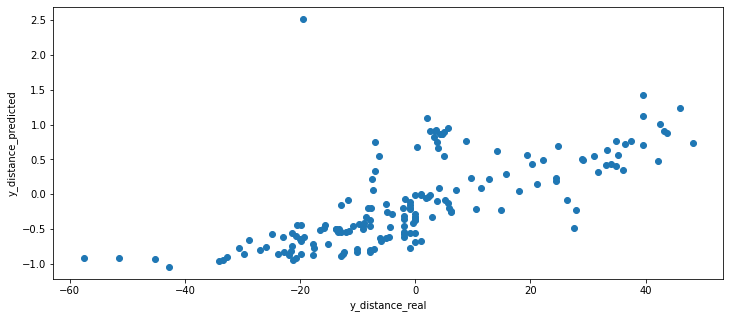

(545, 1)
(545, 1)


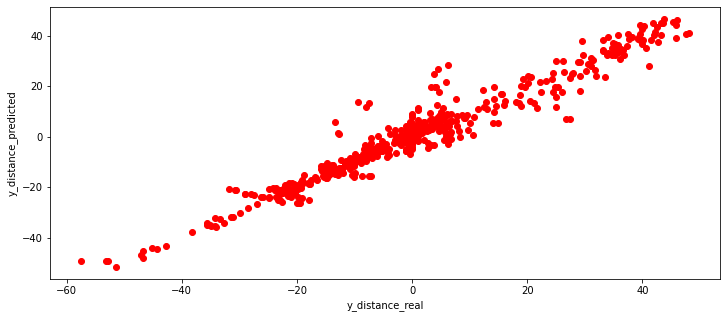

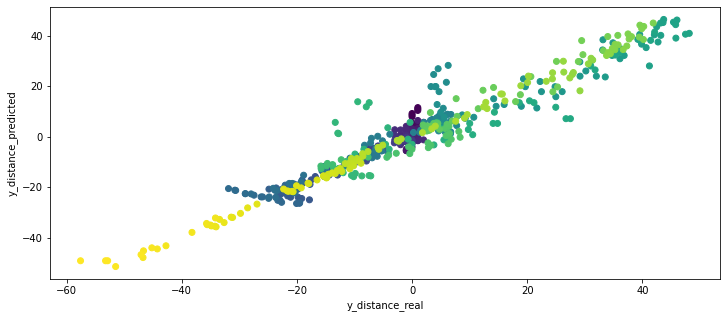

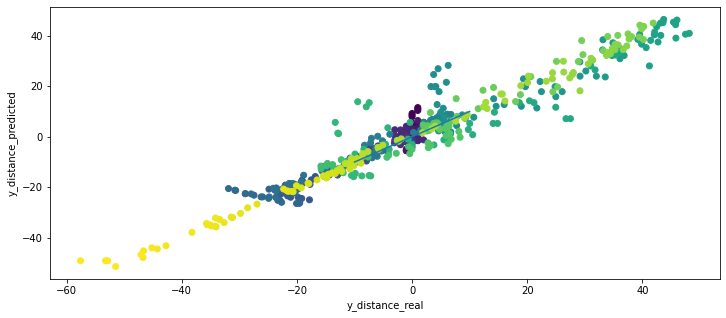

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
170.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  1
Sensor from right wall =  1
most távolsagra van a felső faltól =  108.89620862557285
most távolsagra van az alsó faltól =  8.896208625572825
cccccccccccccccccccccccccccccccccc

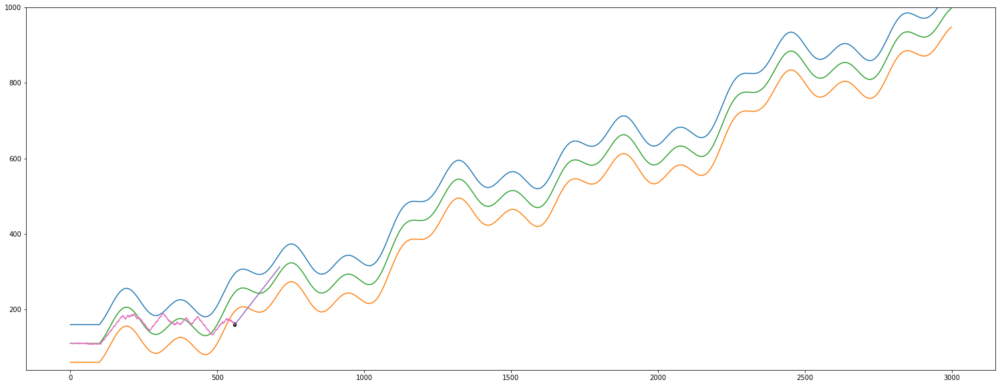

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_right)  =  609
			 self.x                  =  608
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  608
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  1
Sensor from right wall =  1
most távolsagra van a felső faltól =  149.72249049083405
most távolsagra van az alsó faltól =  49.72249049083405
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  608
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -99.72249049083405
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -99.72249049083405
			 ---------------- Teszt 

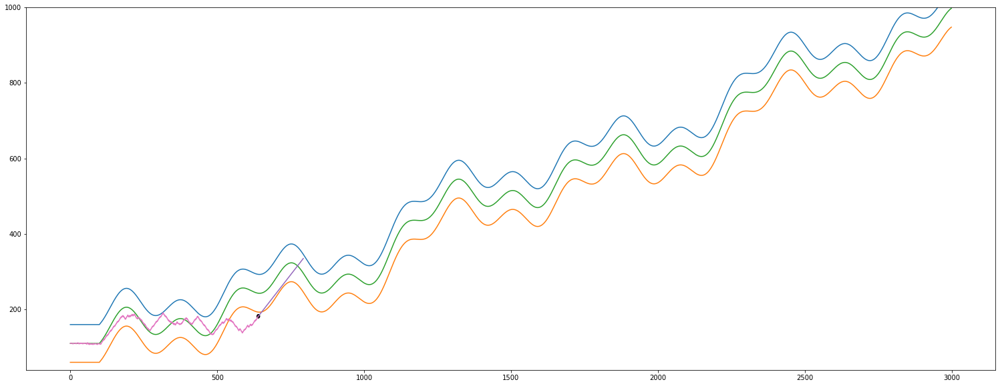

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  640
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[154   1   1]]
actual predicted =  [-0.67073312]
actual self.y_distance[-1] =  -61.01938283811228
len(self.y_distance_real)      =  207
len(self.y_distance_predicted) =  207


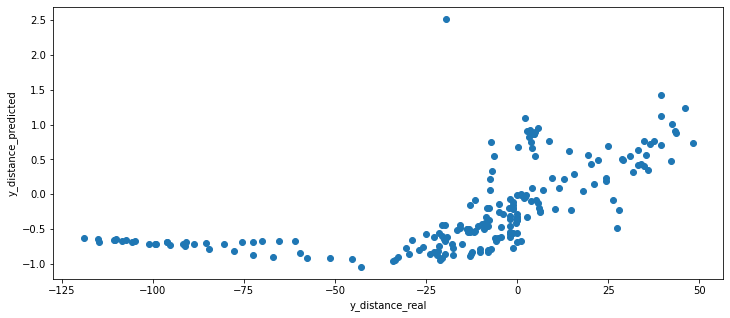

(641, 1)
(641, 1)


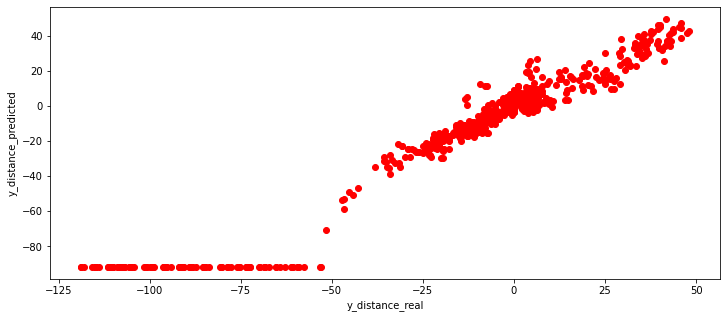

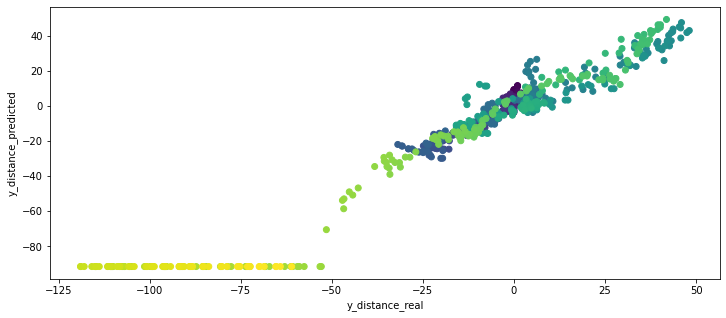

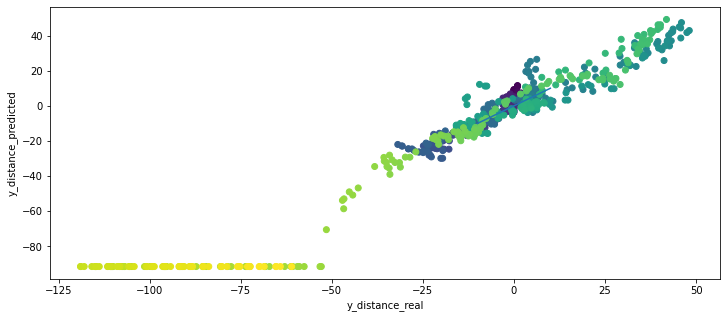

Streaming output truncated to the last 5000 lines.
		  distance from 0 (tmp)=  [[45.29928107]]
		 ---------------------
		 adott j-re -2 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -1
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[115  -1]]
		 _X_center =  [[ 4 -1]]
		 _X_right  =  [[ 3 -1]]
		 predicted_left   =  [[115.8092331]]
		 predicted_center =  [[4.4686163]]
		 predicted_right  =  [[2.41500003]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99777475 -1.06513649]]
		 regression_center.coef_ =  [[ 0.99208071 -0.50029346]]
		 regression_r

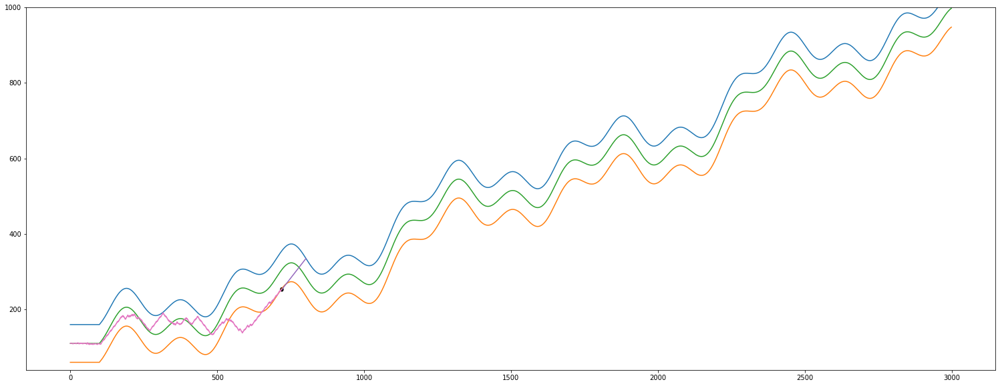

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  720
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (721, 3)
y.shape =  (721, 1)
i       =  720
---------------------
X.max =  154
X.min =  1
X[:,0].max =  154
X[:,0].min =  5
X[:,1].max =  150
X[:,1].min =  1
X[:,2].max =  102
X[:,2].min =  1
y.max =  48.1475565023791
y.min =  -118.97255991743663
---------------------
X_scaled.shape =  (721, 3)
y_scaled.shape =  (721, 1)
X_scaled.max =  1.0000000000000002
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0000000000000002
X_scaled[:,0].min =  -0.9999999999999999
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  0.9999999999999999
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  720
  Ha már 

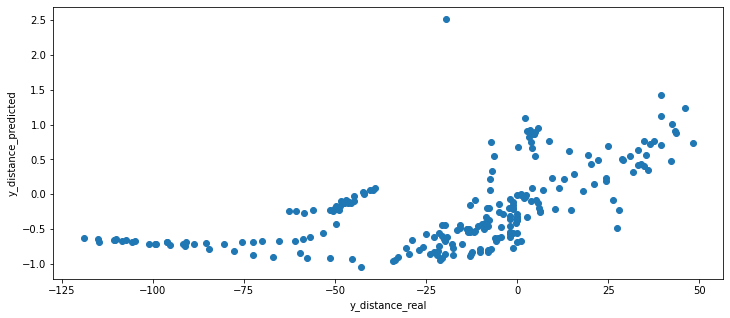

(737, 1)
(737, 1)


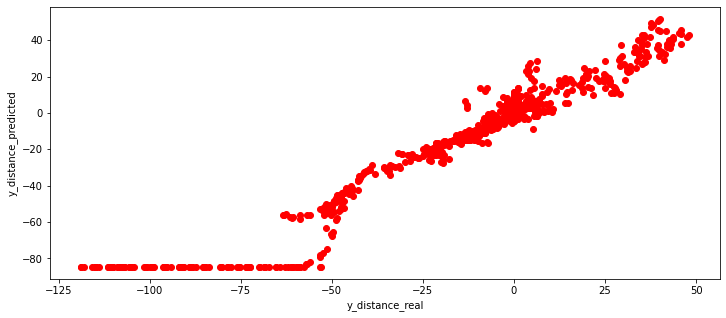

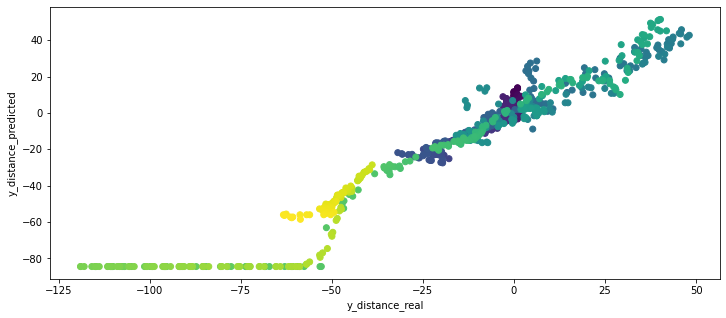

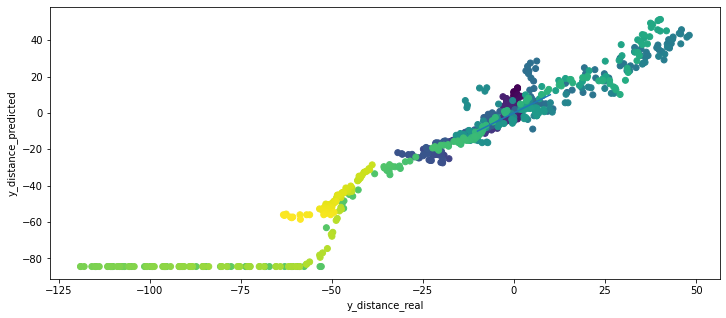

Streaming output truncated to the last 5000 lines.
most távolsagra van a felső faltól =  98.5686054707707
most távolsagra van az alsó faltól =  1.4313945292292942
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  767
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -48.568605470770706
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -48.568605470770706
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  768
			 len(self.sensor_left)   =  768
			 len(self.sensor_center) =  768
			 len(self.sensor_right)  =  768
			 self.x                  =  767
			 -------------- Teszt End --------------
self.y =  271.0
# A run ciklus vége -----------------------------------------------------------------------------------------------------

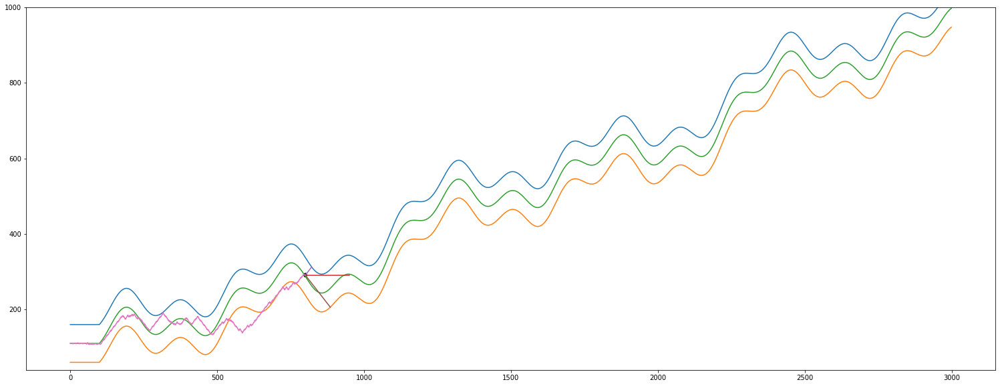

 --- plot --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  800
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  23
Sensor from right wall =  85
most távolsagra van a felső faltól =  47.70664647533977
most távolsagra van az alsó faltól =  52.29335352466026
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  800
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  2.2933535246602332
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  2.2933535246602332
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  801
			 len(self.sensor_left)   =  801
			 len(self.sensor_center) =  801
			 len(self.sensor_

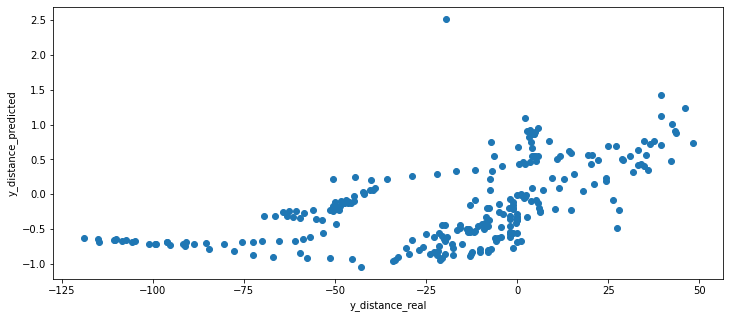

(833, 1)
(833, 1)


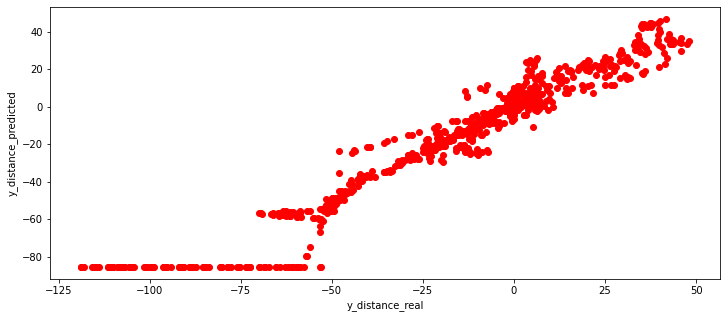

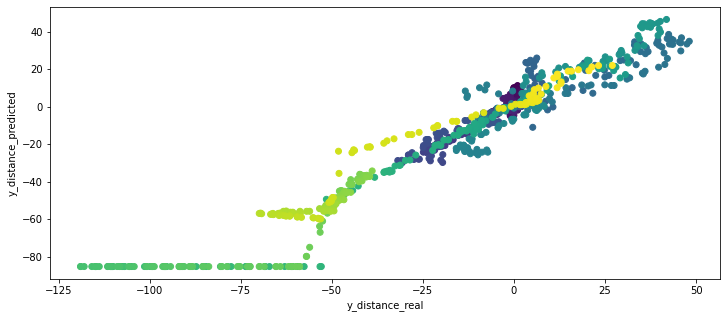

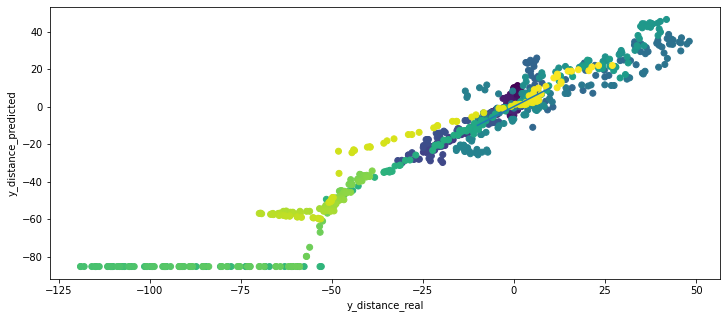

Streaming output truncated to the last 5000 lines.
actual predicted =  [0.8236859]
actual self.y_distance[-1] =  49.19076621390718
len(self.y_distance_real)      =  276
len(self.y_distance_predicted) =  276
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
294.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center

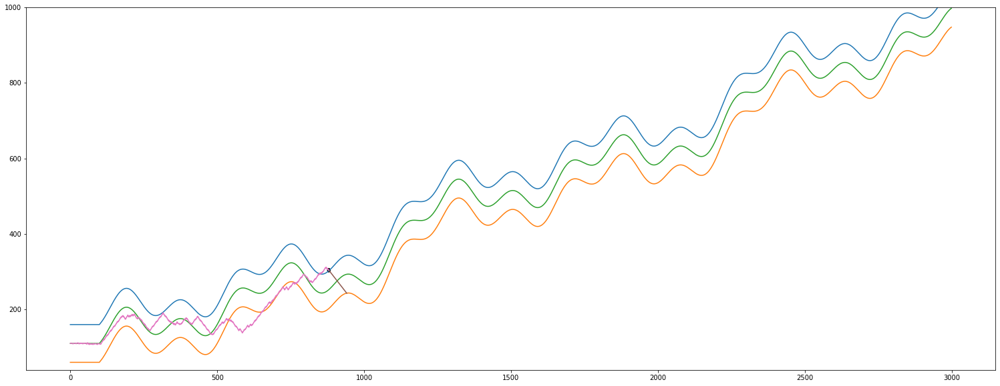

Streaming output truncated to the last 5000 lines.
		 adott j-re 0 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  1
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[53  1]]
		 _X_center =  [[150   1]]
		 _X_right  =  [[49  1]]
		 predicted_left   =  [[51.95536253]]
		 predicted_center =  [[147.21111532]]
		 predicted_right  =  [[49.54954676]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99814624 -0.94638826]]
		 regression_center.coef_ =  [[ 0.98314232 -0.2602321 ]]
		 regression_right.coef_  =  [[0.99947091 0.57547202]]
		 regression_left.interce

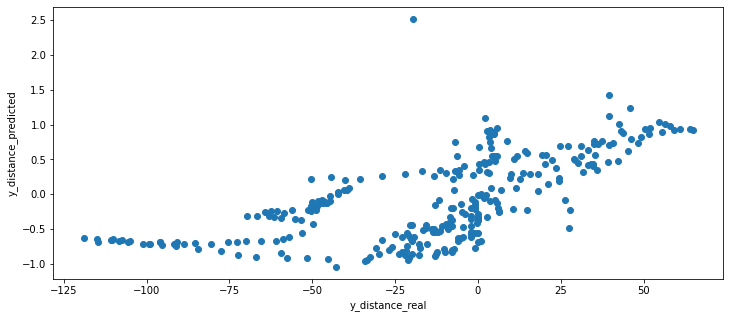

(929, 1)
(929, 1)


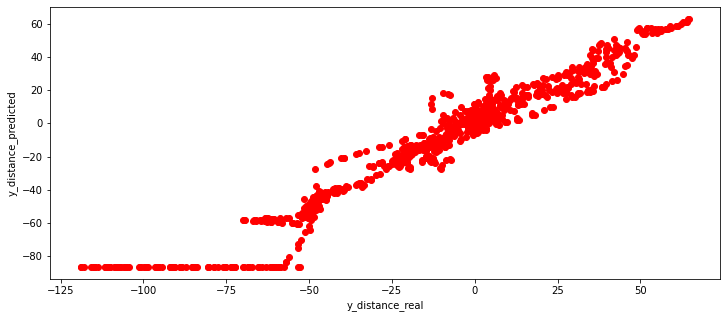

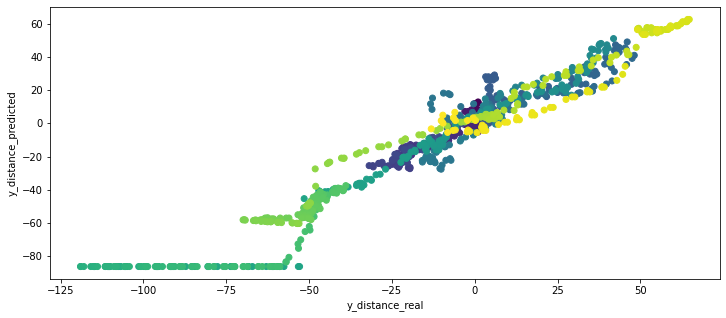

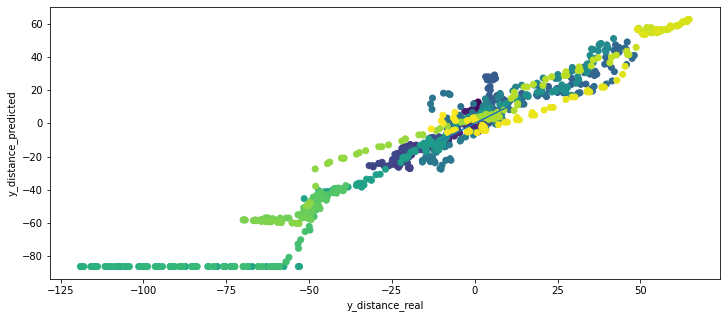

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
276.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  147
Sensor from left wall =  54
Sensor from right wall =  39
most távolsagra van a felső faltól =  63.60621370236339
most távolsagra van az alsó faltól =  36.39378629763661
cccc

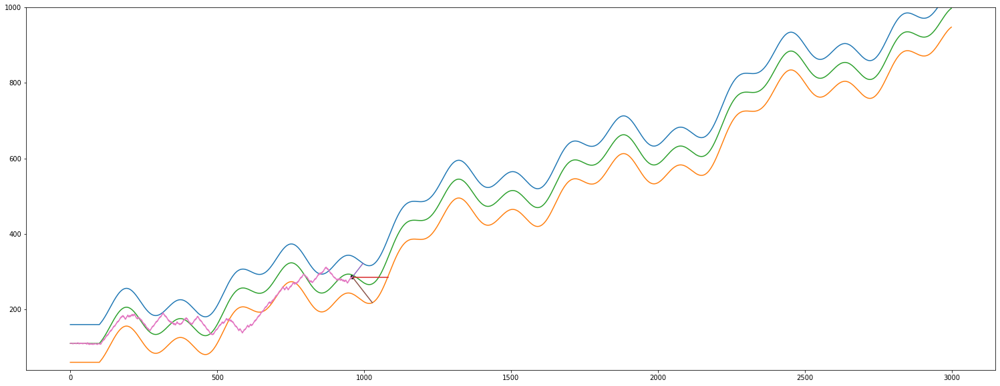

Streaming output truncated to the last 5000 lines.
		 predicted_position neural net model inverz =  [[34.22027908]]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 0 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  1
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[154   1]]
		 _X_center =  [[85  1]]
		 _X_right  =  [[50  1]]
		 predicted_left   =  [[152.9238341]]
		 predicted_center =  [[83.55696117]]
		 predicted_right  =  [[50.61029338]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos -------------------

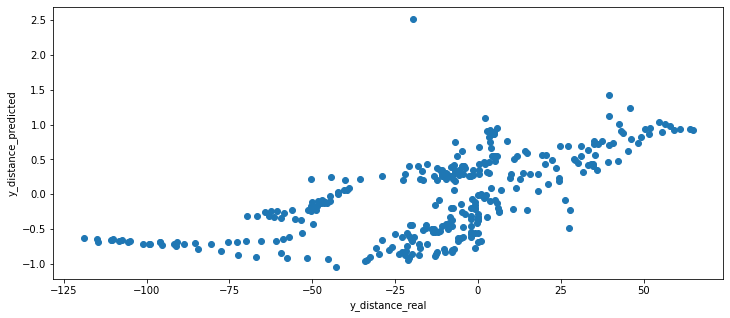

(1025, 1)
(1025, 1)


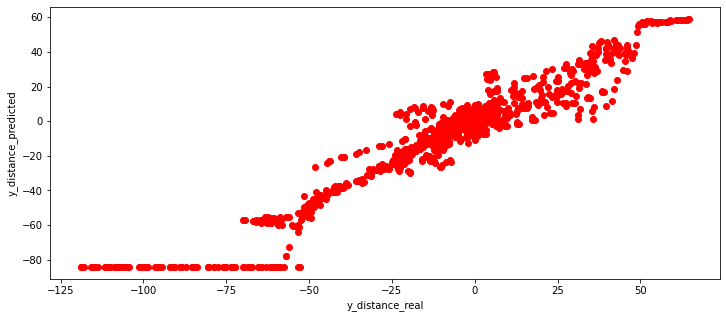

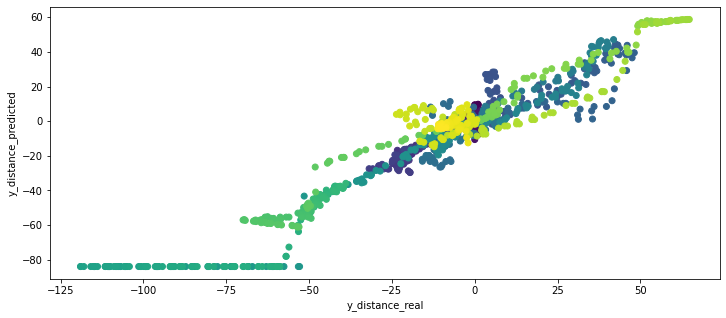

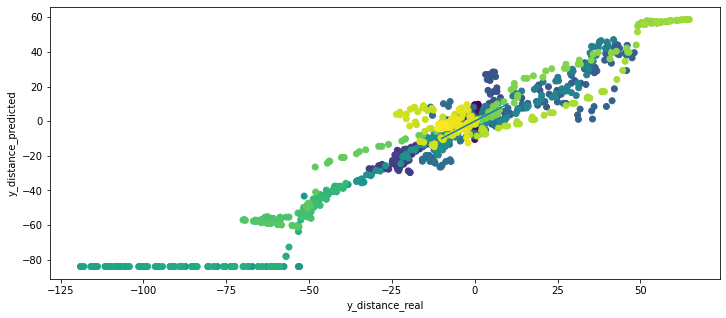

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
258.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  41
Sensor from right wall =  25
most távolsagra van a felső faltól =  58.92084203445722
most távolsagra van az alsó faltól =  41.079157965542805
cccccccccccccccccccccccccccccccc

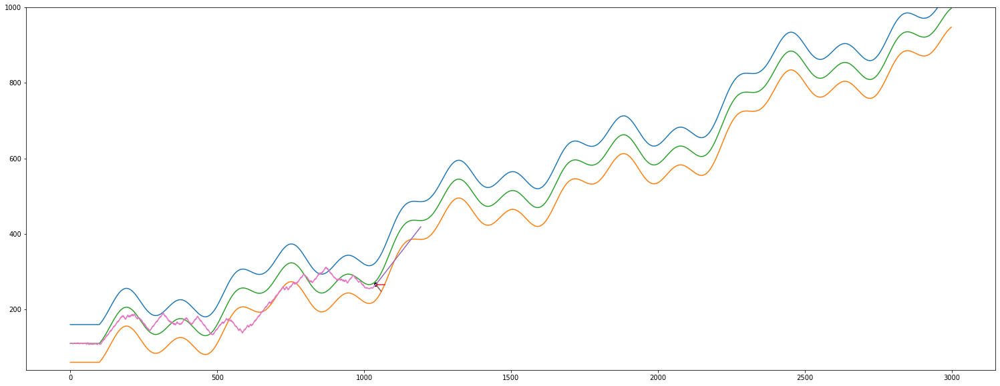

Streaming output truncated to the last 5000 lines.
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  1
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  7
Sensor from right wall =  4
most távolsagra van a felső faltól =  89.41056241671765
most távolsagra van az alsó faltól =  10.589437583282347
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1089
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_dist

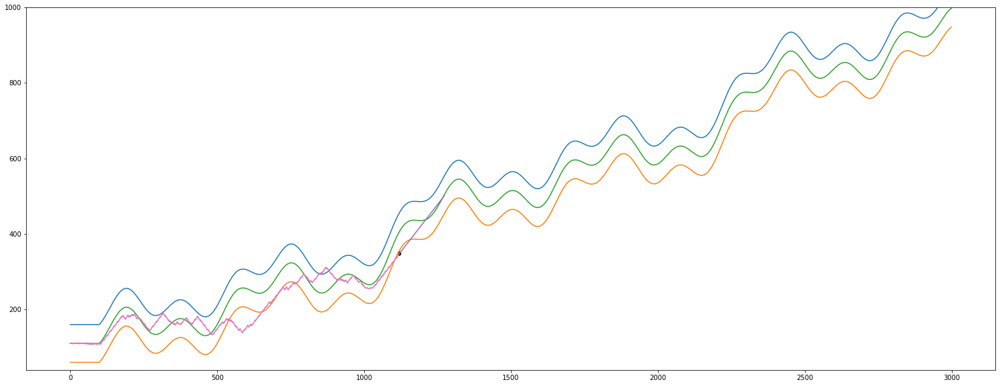

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1120
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[154   1   1]]
actual predicted =  [-0.60281961]
actual self.y_distance[-1] =  -58.10639266711519
len(self.y_distance_real)      =  367
len(self.y_distance_predicted) =  367


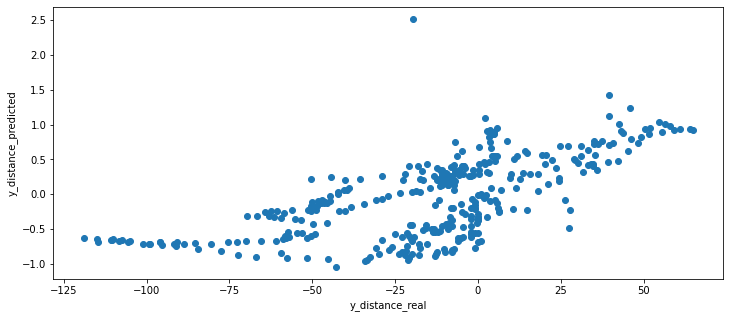

(1121, 1)
(1121, 1)


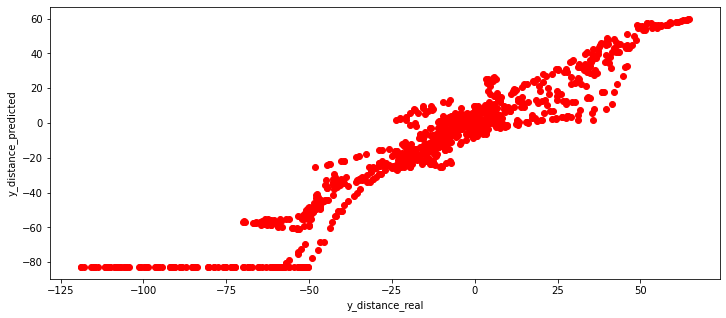

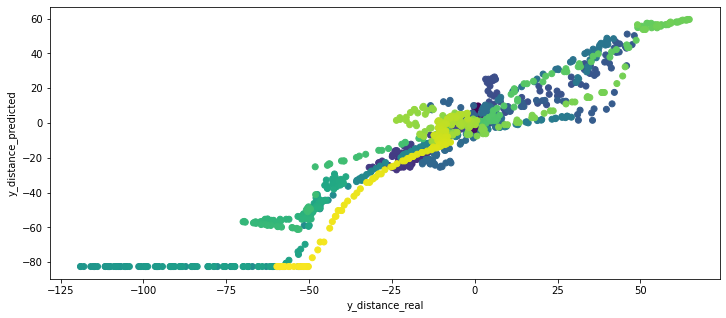

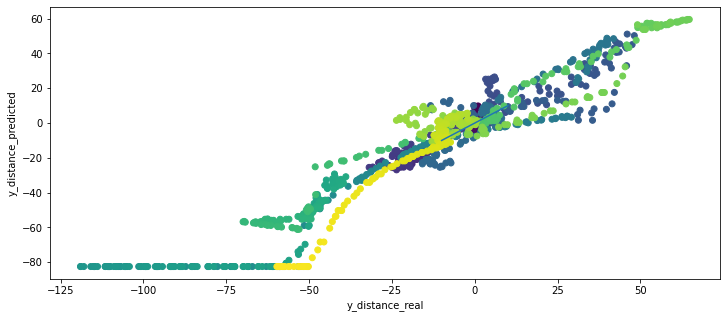

Streaming output truncated to the last 5000 lines.
		 predicted_center =  [[55.29680724]]
		 predicted_right  =  [[6.23459911]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1.00115482 -0.83972327]]
		 regression_center.coef_ =  [[ 0.98561796 -0.03406709]]
		 regression_right.coef_  =  [[0.99940306 0.58687512]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[156.6970123   55.29680724   6.23459911]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-47.74523886]]
		 predicted_position neural net model scaled =  [-0.14126996]
		 predicted_position neural net model inverz =  [[-40.09216696]]
		 ------------

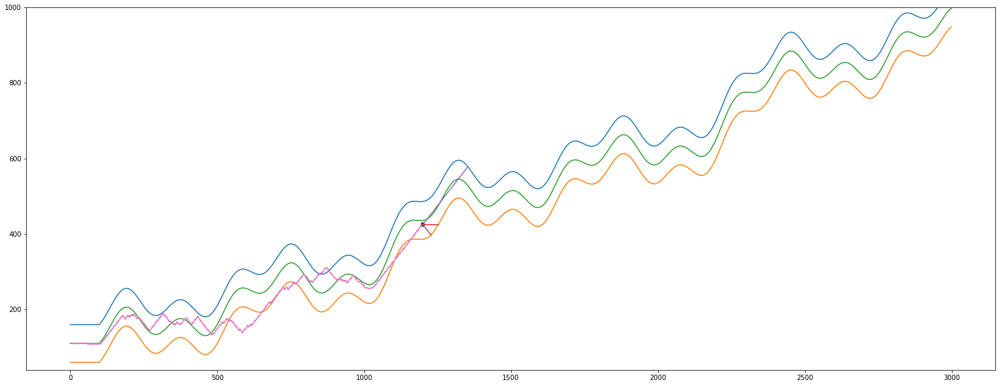

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1200
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1201, 3)
y.shape =  (1201, 1)
i       =  1200
---------------------
X.max =  154
X.min =  1
X[:,0].max =  154
X[:,0].min =  1
X[:,1].max =  150
X[:,1].min =  1
X[:,2].max =  102
X[:,2].min =  1
y.max =  64.74150502310039
y.min =  -118.97255991743663
---------------------
X_scaled.shape =  (1201, 3)
y_scaled.shape =  (1201, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  1200
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül

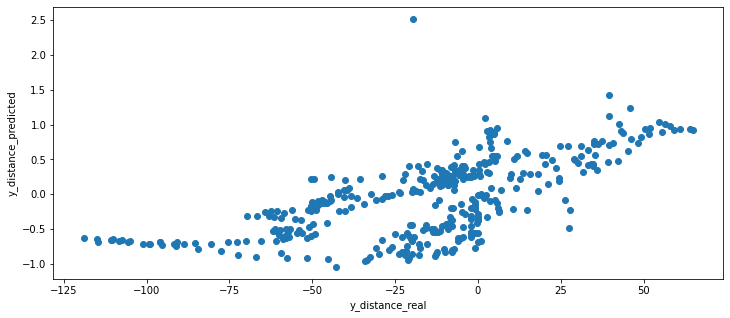

(1217, 1)
(1217, 1)


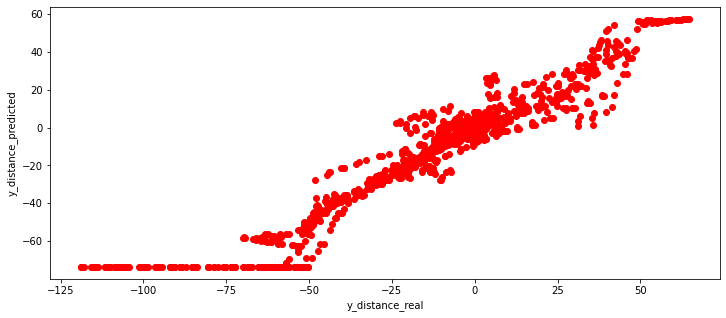

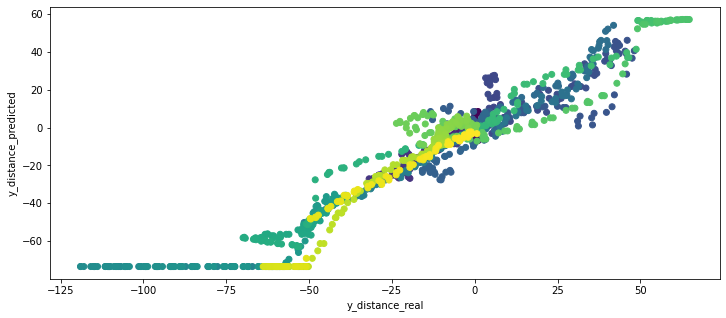

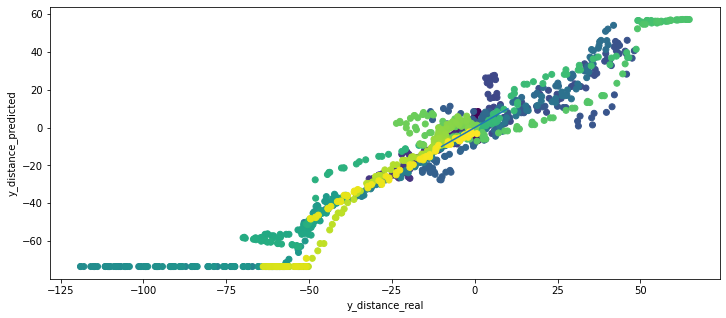

Streaming output truncated to the last 5000 lines.




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[111  -3]]
		 _X_center =  [[33 -3]]
		 _X_right  =  [[19 -3]]
		 predicted_left   =  [[113.60225164]]
		 predicted_center =  [[32.44240375]]
		 predicted_right  =  [[17.20815055]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1.00153433 -0.810647  ]]
		 regression_center.coef_ =  [[0.98621766 0.03425969]]
		 regression_right.coef_  =  [[0.99946139 0.59387195]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[113.60225164  32.44240375  17.20815055]]
		 ---------------Brut

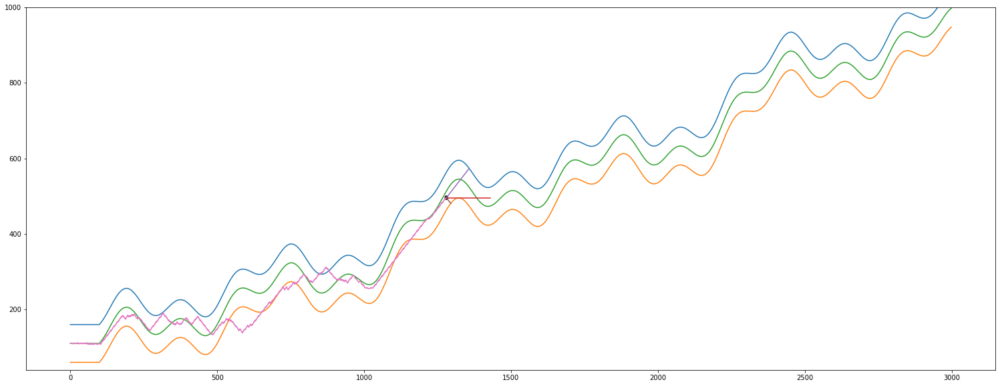

 --- plot --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  1280
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor from left wall =  79
Sensor from right wall =  15
most távolsagra van a felső faltól =  68.4873243557247
most távolsagra van az alsó faltól =  31.51267564427536
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1280
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -18.487324355724695
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -18.487324355724695
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1281
			 len(self.sensor_left)   =  1281
			 len(self.sensor_center) =  1281
			 len(self.s

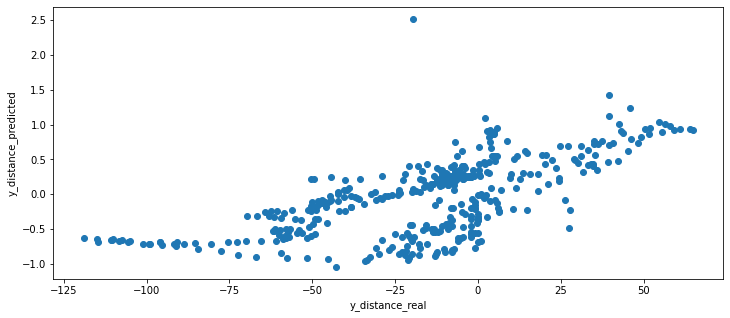

(1313, 1)
(1313, 1)


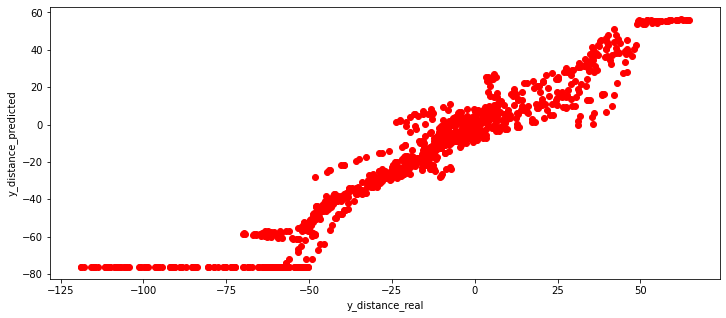

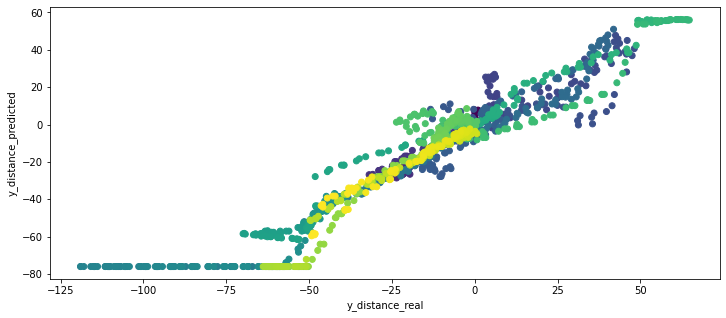

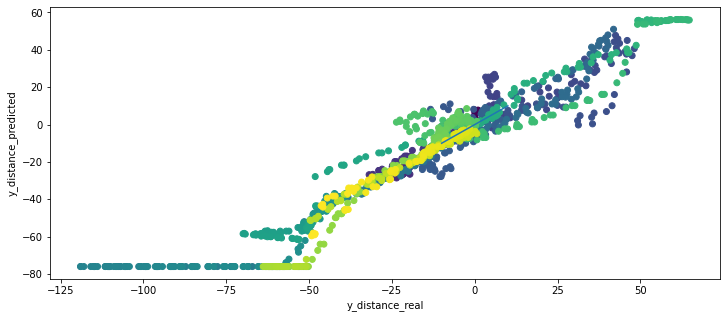

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_left)   =  1327
			 len(self.sensor_center) =  1327
			 len(self.sensor_right)  =  1327
			 self.x                  =  1327
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1328
			 len(self.sensor_left)   =  1328
			 len(self.sensor_center) =  1328
			 len(self.sensor_right)  =  1328
			 self.x                  =  1327
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1327
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 53 150   3]]
actual predicted =  [-0.26433504]
actual self.y_distance[-1] =  -48.80532949754888
len(self.y_distance_real)      =  436
len(self.y_distance_predicted) =  436
# A run ciklus vége -------------------------------------------------

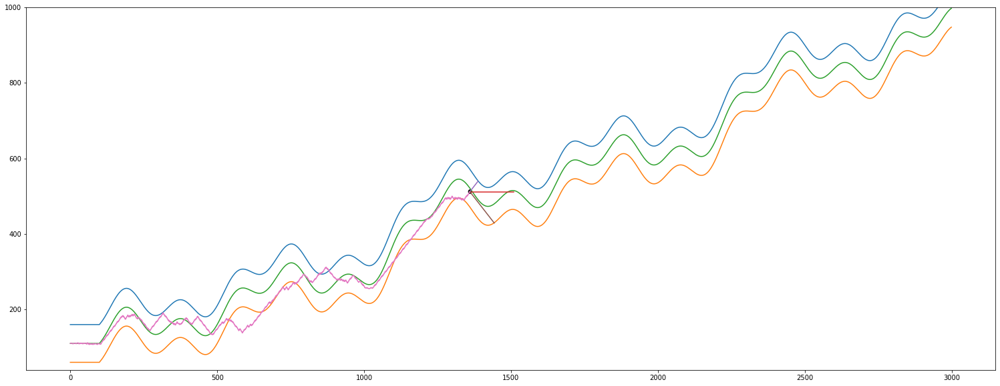

Streaming output truncated to the last 5000 lines.
len(self.y_distance_real)      =  452
len(self.y_distance_predicted) =  452
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
505.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor from left wall =  25
Sensor from right wall =  73
most távolsagra van a felső faltól =

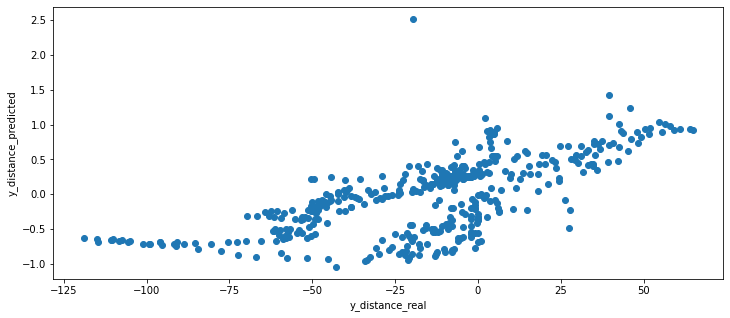

(1409, 1)
(1409, 1)


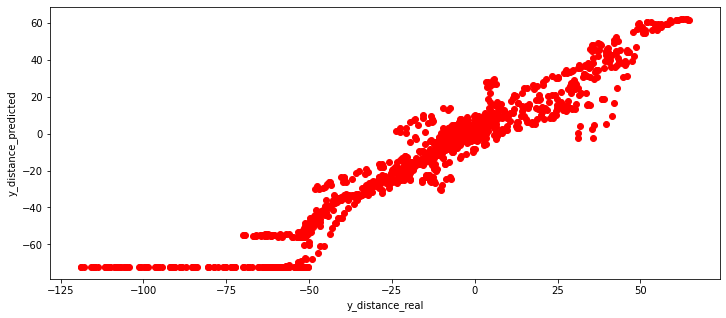

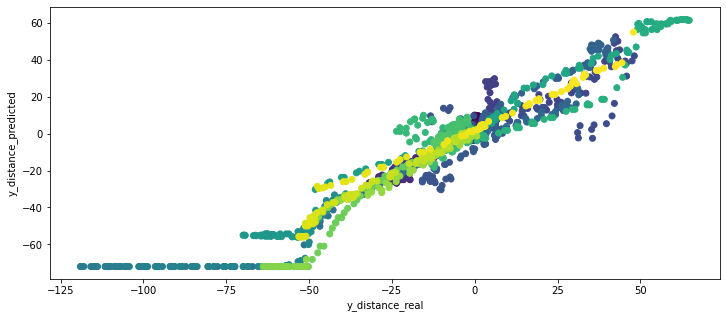

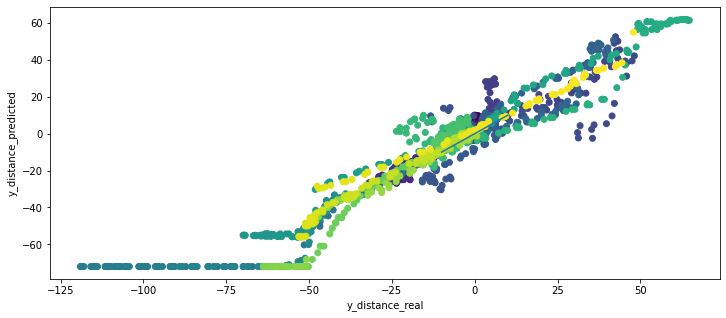

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
524.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  6
Sensor from left wall =  2
Sensor from right wall =  70
most távolsagra van a felső faltól =  1.678910789909878
most távolsagra van az alsó faltól =  98.32108921009018
ccccccc

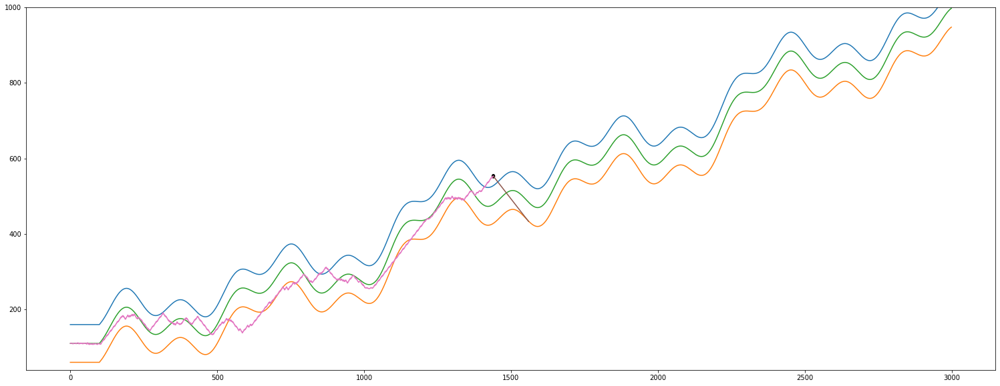

Streaming output truncated to the last 5000 lines.
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
586.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  1
Sensor from left wall =  1
Sensor from right wall =  150
most távolsagra van a felső faltól =  35.21852550283643
most távolsagra van az alsó faltól =  135.21852550283637
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1472
ccccccccccccccccccccccccccccccccccccccccc

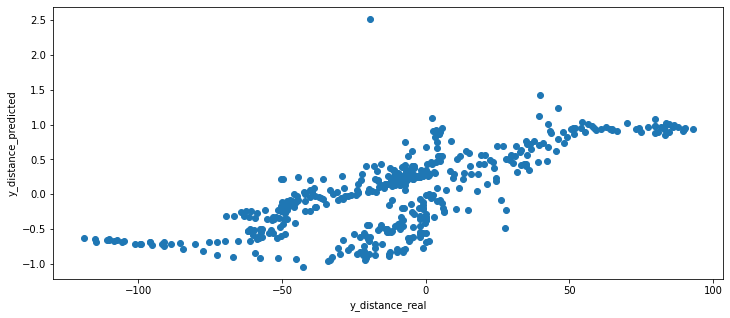

(1505, 1)
(1505, 1)


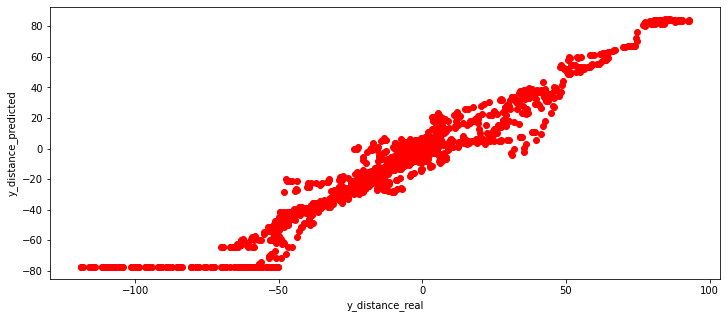

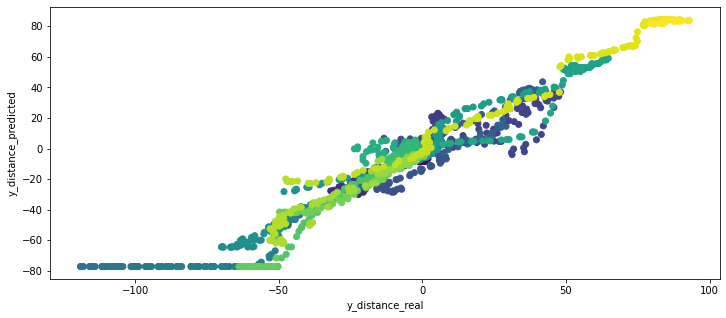

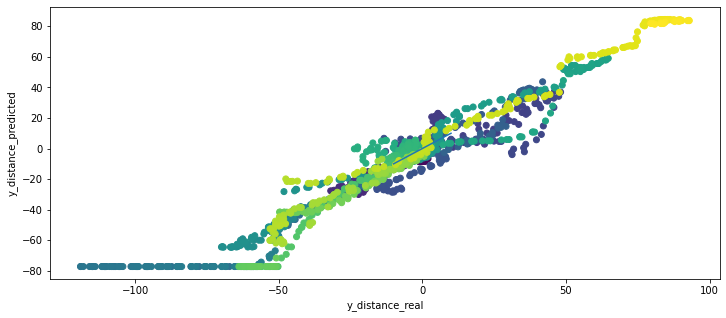

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
596.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  1
Sensor from left wall =  1
Sensor from right wall =  135
most távolsagra van a felső faltól =  30.876548645980392
most távolsagra van az alsó faltól =  130.87654864598034
cccc

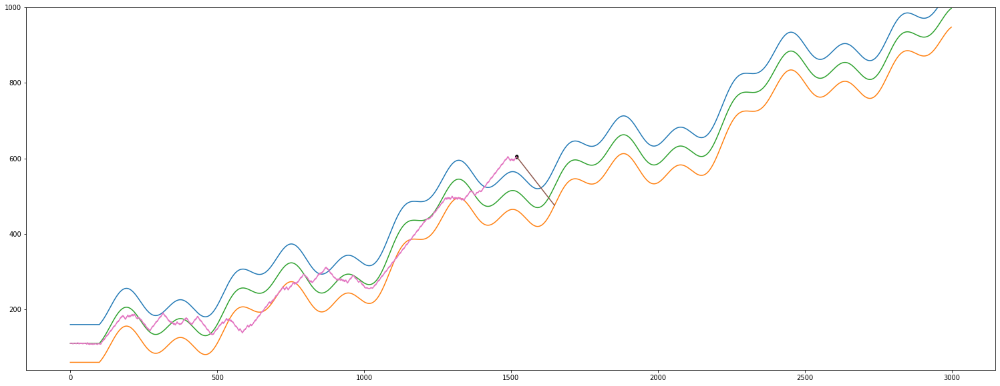

Streaming output truncated to the last 5000 lines.
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  172.96473859614298
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  172.96473859614298
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1569
			 len(self.sensor_left)   =  1569
			 len(self.sensor_center) =  1569
			 len(self.sensor_right)  =  1569
			 self.x                  =  1568
			 -------------- Teszt End --------------
self.y =  651.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
651.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 	

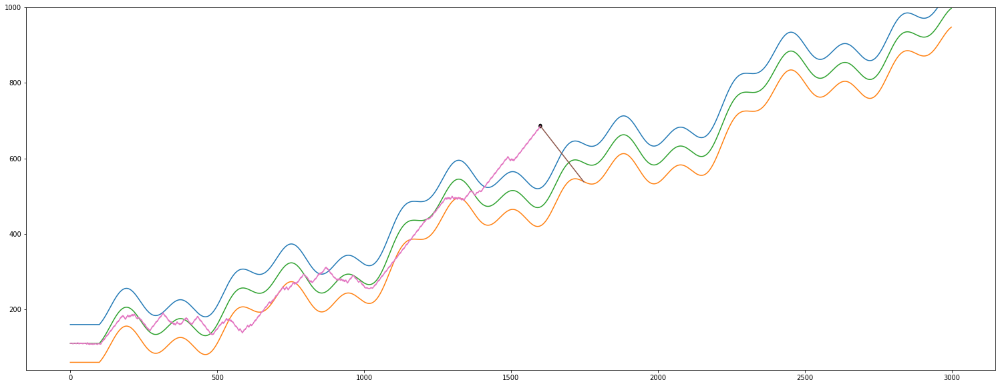

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1600
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[  1   1 149]]
actual predicted =  [0.24468729]
actual self.y_distance[-1] =  214.50294120334058
len(self.y_distance_real)      =  527
len(self.y_distance_predicted) =  527


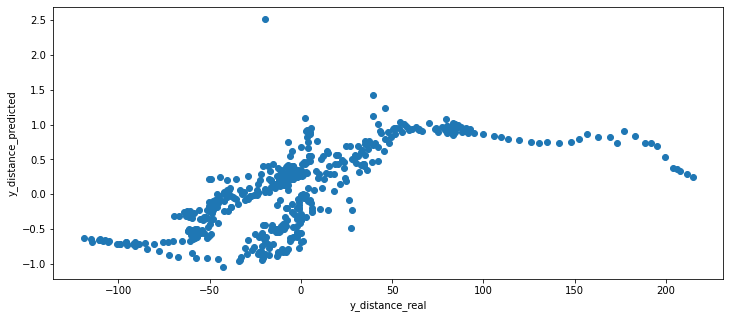

(1601, 1)
(1601, 1)


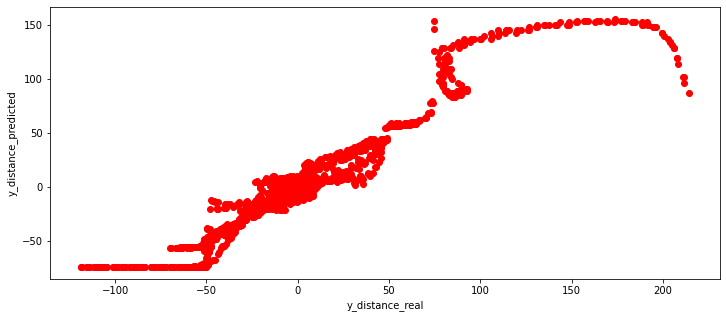

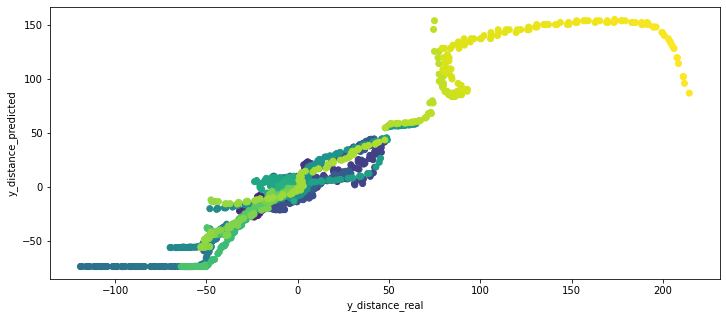

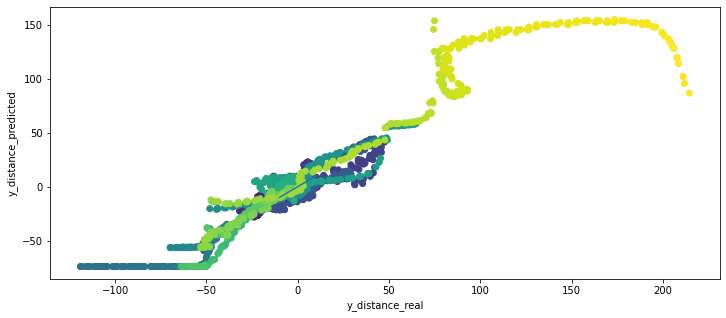

Streaming output truncated to the last 5000 lines.
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[  2.9517947   -3.17359713 148.67562683]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[135.34370826]]
		 predicted_position neural net model scaled =  [0.72895741]
		 predicted_position neural net model inverz =  [[172.17745079]]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  -3
		  predicted_position =  [[172.17745079]]
		  distance from 0 (tmp)=  [[172.17745079]]
		 ---------------------
		 adott j-re -3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 ---------------

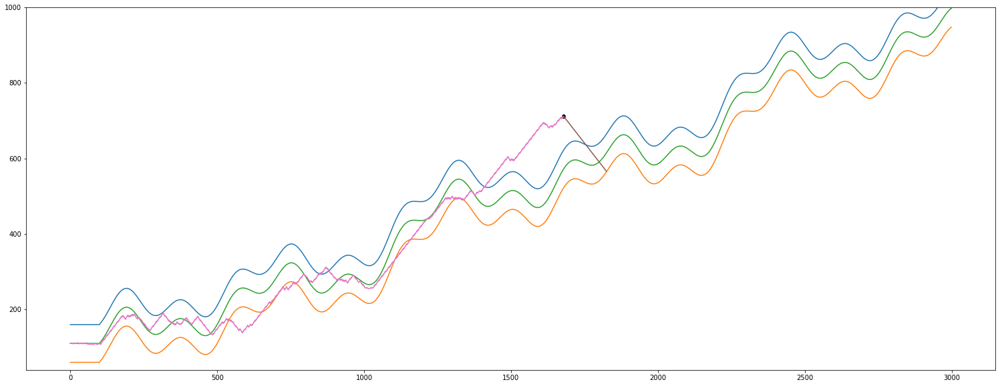

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1680
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1681, 3)
y.shape =  (1681, 1)
i       =  1680
---------------------
X.max =  154
X.min =  1
X[:,0].max =  154
X[:,0].min =  1
X[:,1].max =  150
X[:,1].min =  1
X[:,2].max =  154
X[:,2].min =  1
y.max =  217.82001673187415
y.min =  -118.97255991743663
---------------------
X_scaled.shape =  (1681, 3)
y_scaled.shape =  (1681, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  1680
  Ha már van elég before after adatunk
# 3. Tanulás itt kerü

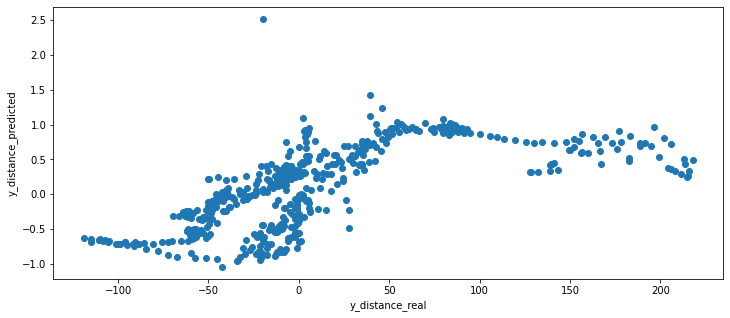

(1697, 1)
(1697, 1)


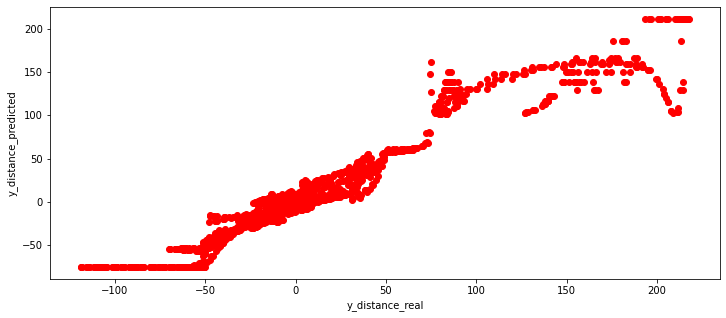

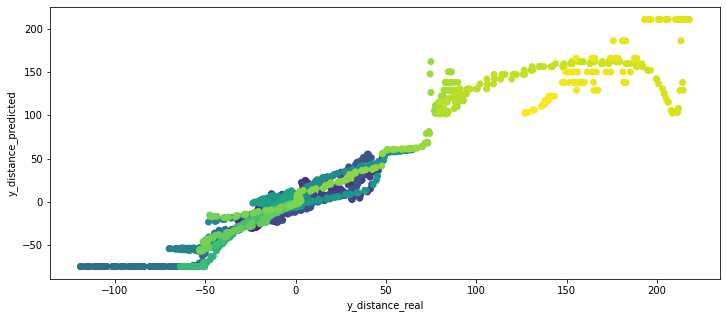

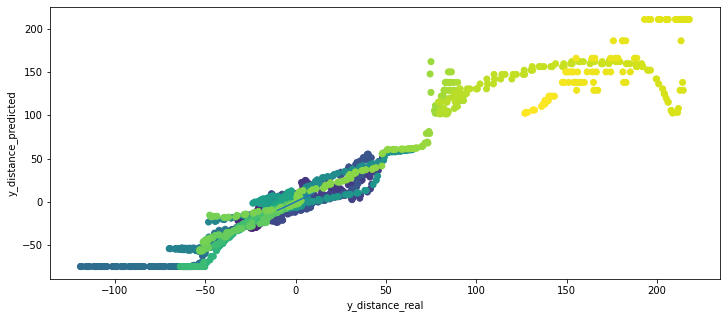

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_left)   =  1728
			 len(self.sensor_center) =  1728
			 len(self.sensor_right)  =  1728
			 self.x                  =  1727
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  1727
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  1
Sensor from left wall =  1
Sensor from right wall =  140
most távolsagra van a felső faltól =  100.57059882343435
most távolsagra van az alsó faltól =  200.57059882343435
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1727
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  150.57059882343435
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, 

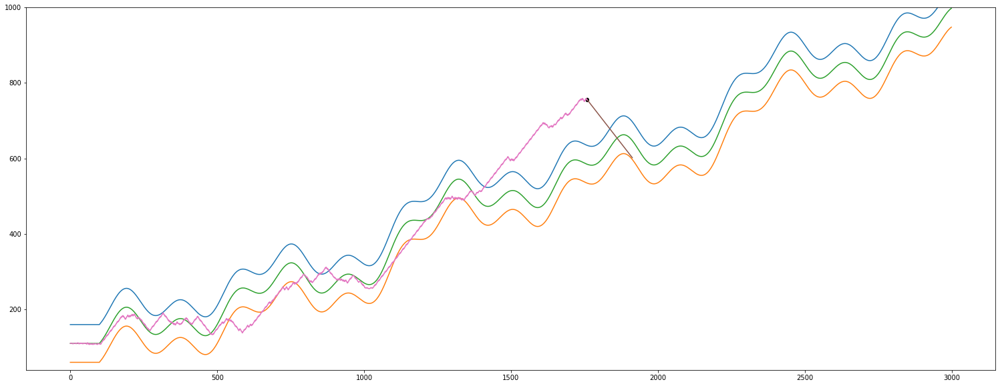

 --- plot --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  1760
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  1
Sensor from left wall =  1
most távolsagra van a felső faltól =  119.54069368687112
most távolsagra van az alsó faltól =  219.54069368687112
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1760
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  169.54069368687112
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  169.54069368687112
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1761
			 len(self.sensor_left)   =  1761
			 len(self.sensor_center) =  1761
			 len(self.sensor_righ

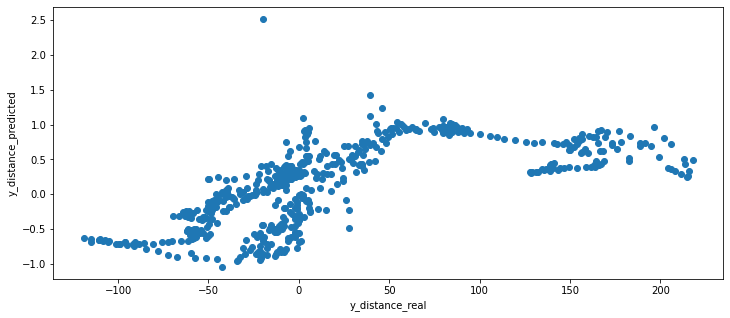

(1793, 1)
(1793, 1)


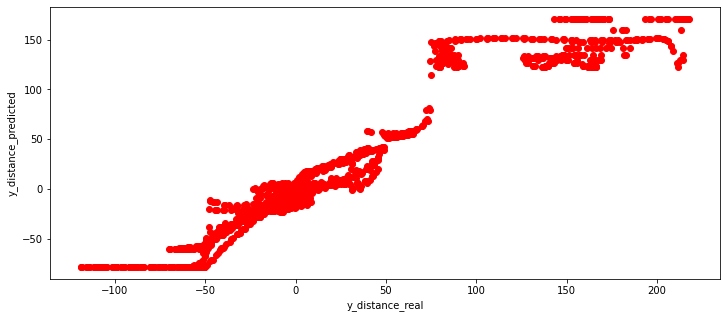

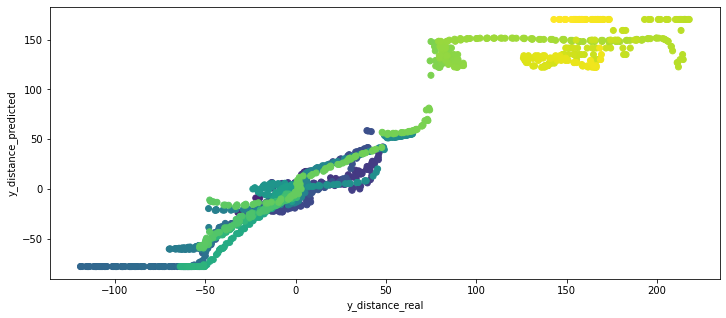

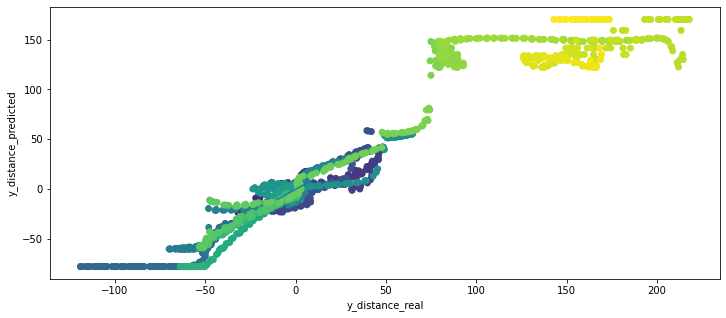

Streaming output truncated to the last 5000 lines.
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  122.77605638451723
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  122.77605638451723
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1807
			 len(self.sensor_left)   =  1807
			 len(self.sensor_center) =  1807
			 len(self.sensor_right)  =  1807
			 self.x                  =  1807
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1808
			 len(self.sensor_left)   =  1808
			 len(self.sensor_center) =  1808
			 len(self.sensor_right)  =  1808
			 self.x                  =  1807
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ----------------------------

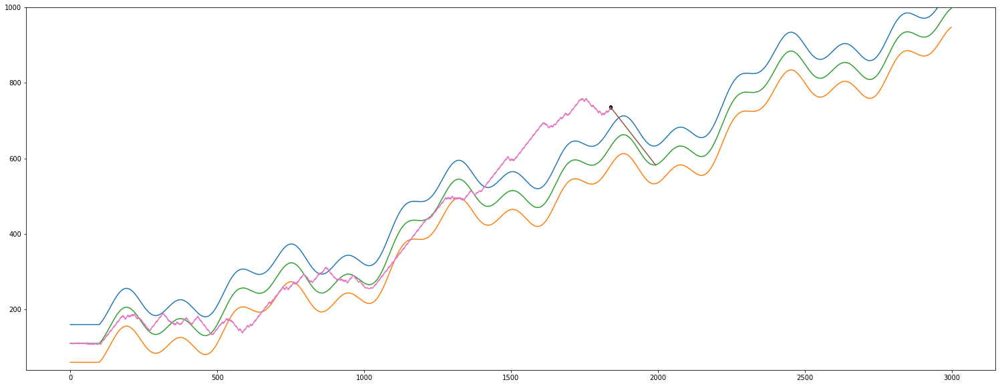

Streaming output truncated to the last 5000 lines.
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[-1.35141061e-01  3.38521579e+00  1.55206539e+02]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[142.08717863]]
		 predicted_position neural net model scaled =  [0.55692759]
		 predicted_position neural net model inverz =  [[143.20826661]]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 2 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük 

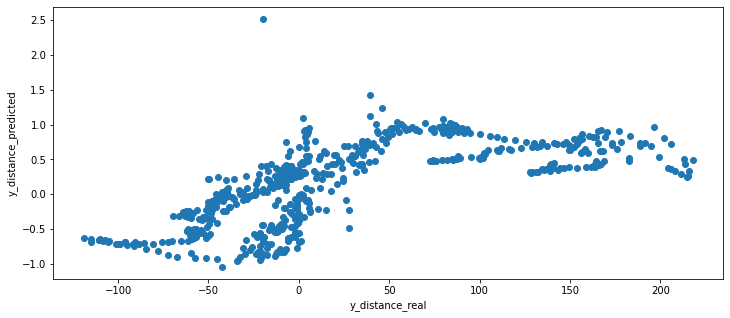

(1889, 1)
(1889, 1)


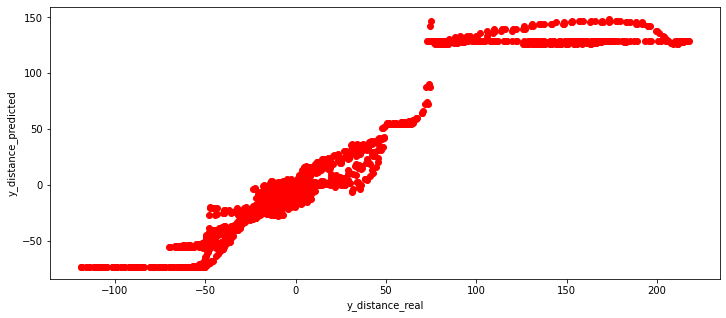

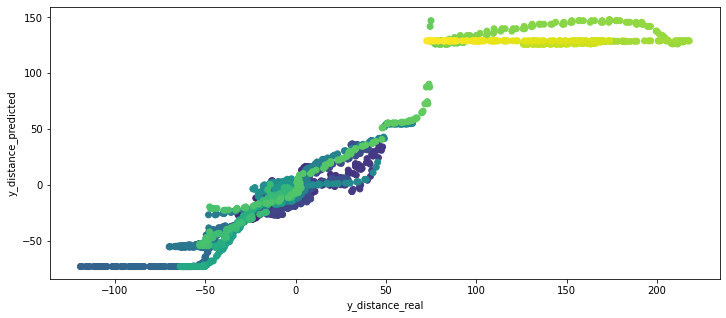

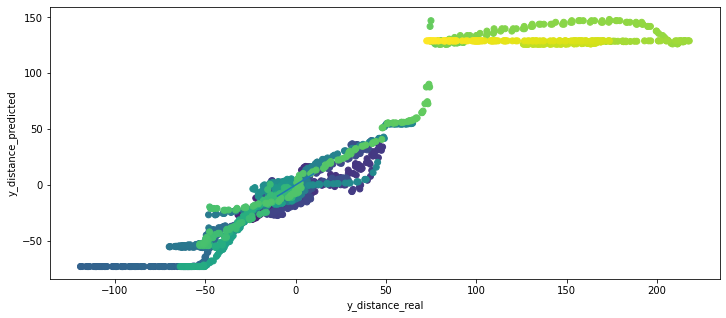

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
735.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  1
Sensor from left wall =  1
most távolsagra van a felső faltól =  22.74893026208872
most távolsagra van az alsó faltól =  122.74893026208872
ccccccccccccccccccccccccccccccccccc

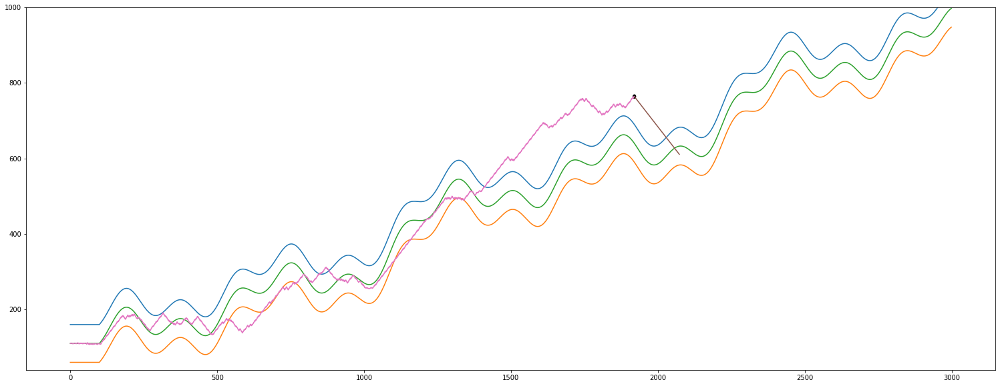

Streaming output truncated to the last 5000 lines.
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1951
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  181.6100647765635
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  181.6100647765635
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1951
			 len(self.sensor_left)   =  1951
			 len(self.sensor_center) =  1951
			 len(self.sensor_right)  =  1951
			 self.x                  =  1951
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1952
			 len(self.sensor_left)   =  1952
			 len(self.sensor_center) =  1952
			 len(self.sensor_right)  =  1952
			 self.x                  =  1951
			 -------------- App

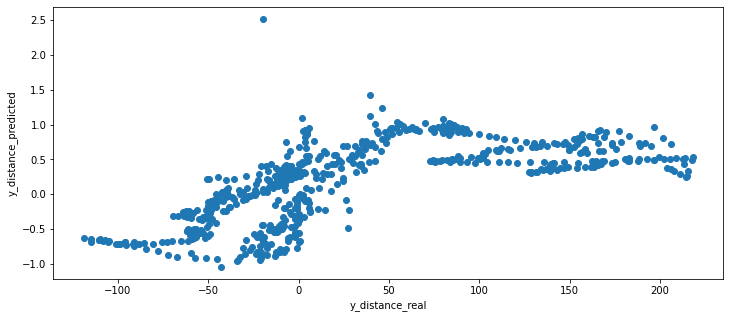

(1985, 1)
(1985, 1)


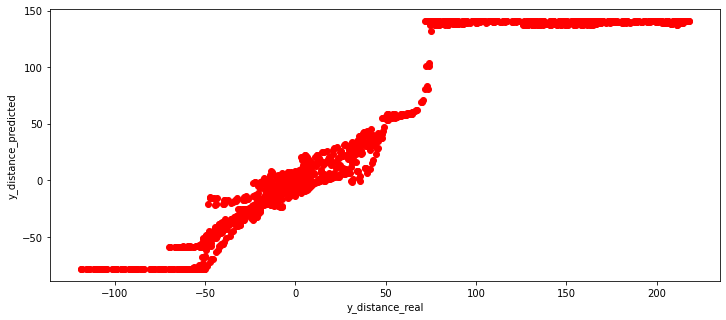

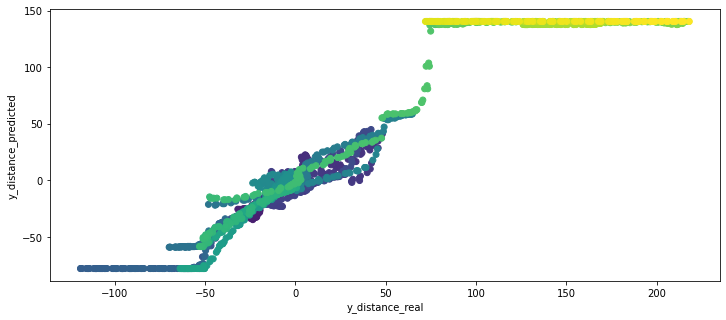

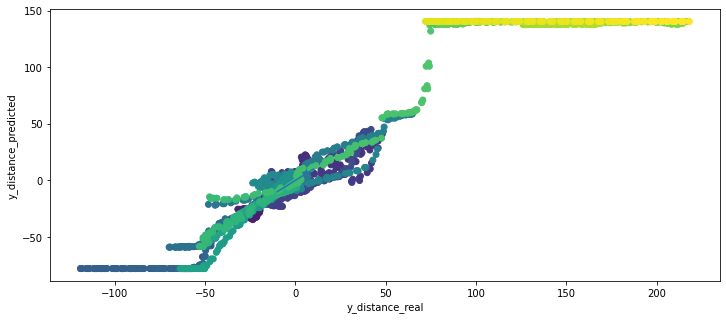

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
801.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  1
Sensor from left wall =  1
most távolsagra van a felső faltól =  168.1442935483799
most távolsagra van az alsó faltól =  268.1442935483799
cccccccccccccccccccccccccccccccccccc

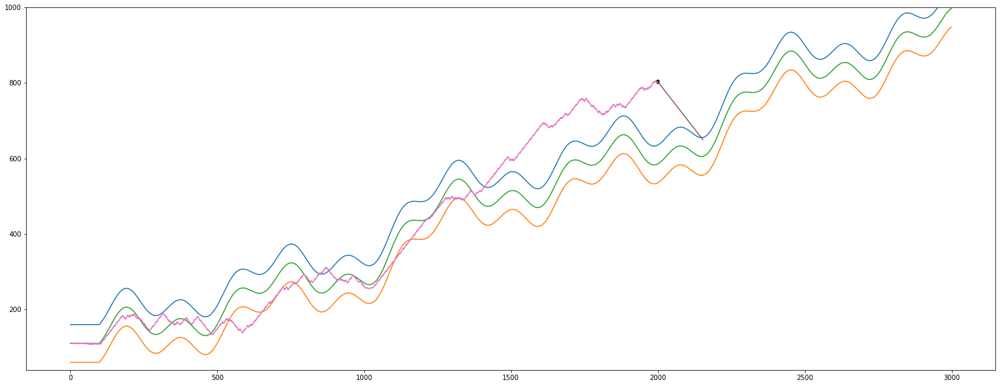

Streaming output truncated to the last 5000 lines.
most távolsagra van a felső faltól =  90.6601321480822
most távolsagra van az alsó faltól =  190.6601321480822
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2046
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  140.6601321480822
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  140.6601321480822
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2047
			 len(self.sensor_left)   =  2047
			 len(self.sensor_center) =  2047
			 len(self.sensor_right)  =  2047
			 self.x                  =  2046
			 -------------- Teszt End --------------
self.y új értéke   =  761.0
action             =  -3
----------------- módosítás vége -----------------
# A run ciklus vége ------------

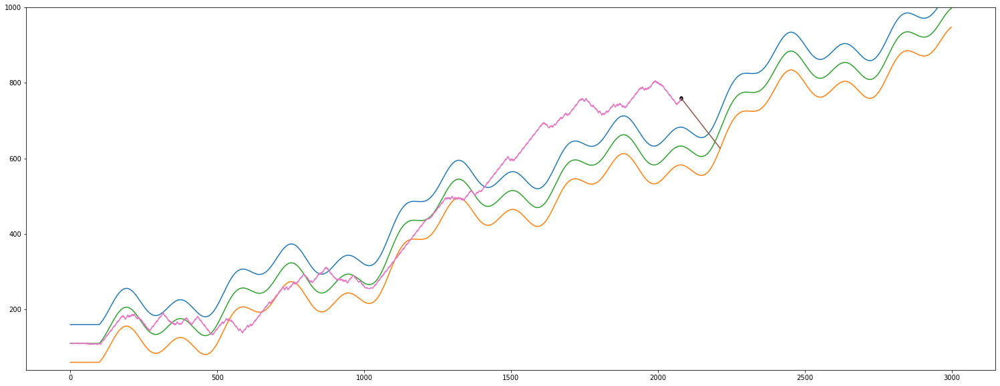

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2080
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[  1   1 133]]
actual predicted =  [0.39580627]
actual self.y_distance[-1] =  126.1341141260798
len(self.y_distance_real)      =  687
len(self.y_distance_predicted) =  687


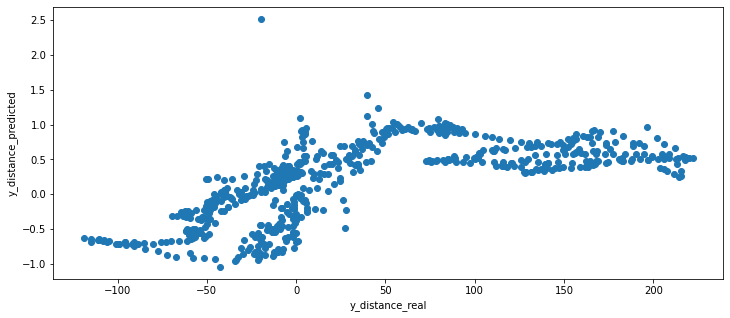

(2081, 1)
(2081, 1)


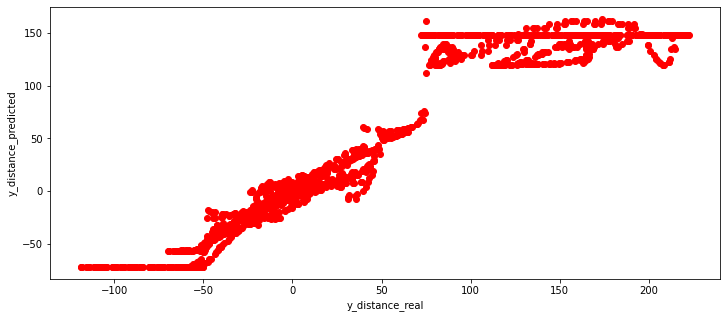

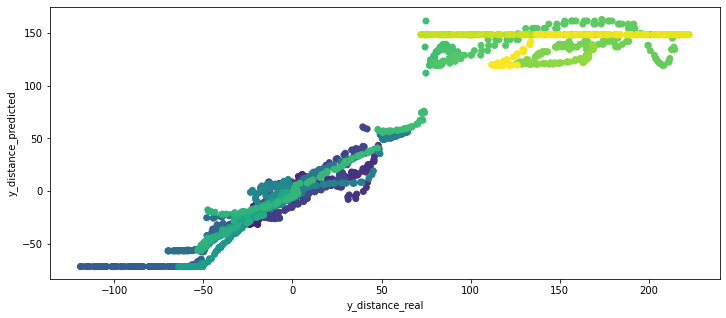

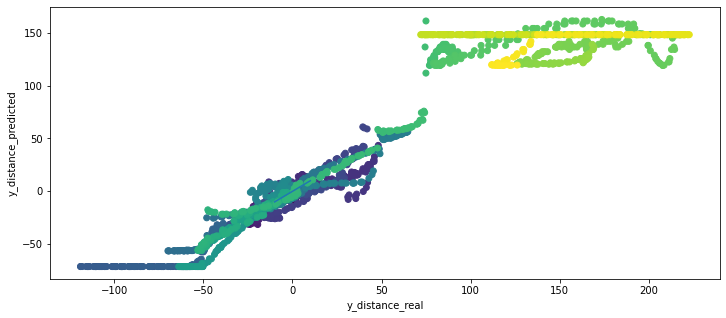

Streaming output truncated to the last 5000 lines.
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------
	 minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  800.0
Sensor center =  1
Sensor from left wall =  1
Sensor from right wall =  118
most távolsagra van a felső faltól =  133.9870758348643
most távolsagra van az alsó faltól =  233.9870758348643
cccccccccccccccccccccccccccccccccccc

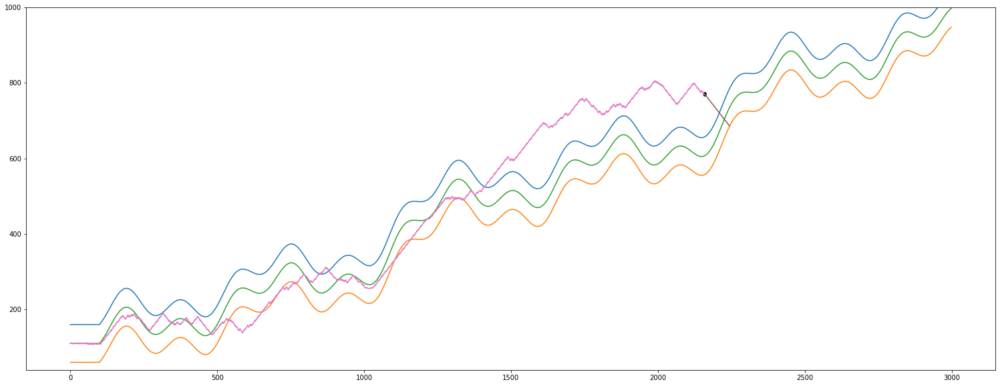

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2160
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2161, 3)
y.shape =  (2161, 1)
i       =  2160
---------------------
X.max =  154
X.min =  1
X[:,0].max =  154
X[:,0].min =  1
X[:,1].max =  150
X[:,1].min =  1
X[:,2].max =  154
X[:,2].min =  1
y.max =  222.72143134182772
y.min =  -118.97255991743663
---------------------
X_scaled.shape =  (2161, 3)
y_scaled.shape =  (2161, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2160
  Ha már van elég before after adatunk
# 3. Tanulás itt kerü

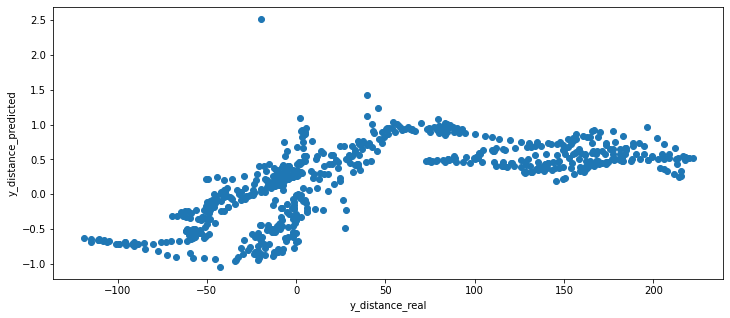

(2177, 1)
(2177, 1)


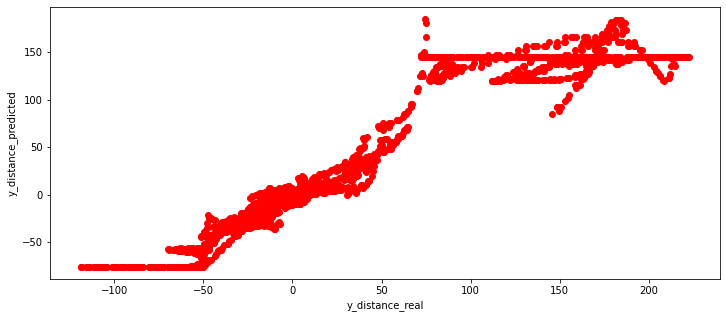

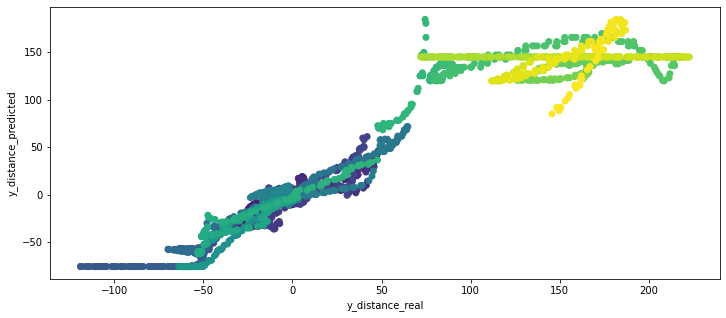

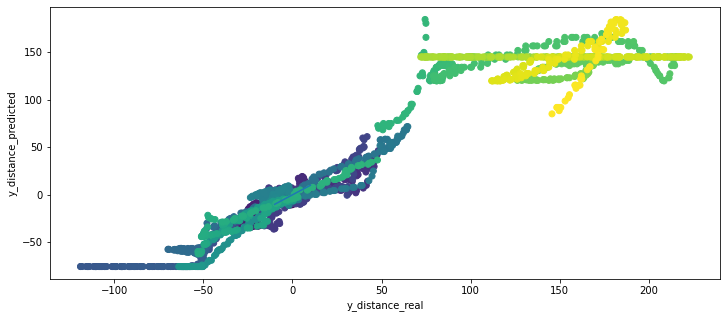

Streaming output truncated to the last 5000 lines.
X[:,0].min =  1
X[:,1].max =  150
X[:,1].min =  1
X[:,2].max =  154
X[:,2].min =  1
y.max =  222.72143134182772
y.min =  -118.97255991743663
---------------------
X_scaled.shape =  (2209, 3)
y_scaled.shape =  (2209, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2208
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
delta_array = 
 [[ 0.  0.  0.  0.]
 [ 1. -1.  1.  1.]
 [ 0.  0.  0.  0.]
 ...
 [-1.  0.  0.  0.]
 [ 3.  0.  0.  2.]
 [ 1.  0.  0.  1.]]
# Linear Regression Learning -------------------------------------------------------------------------

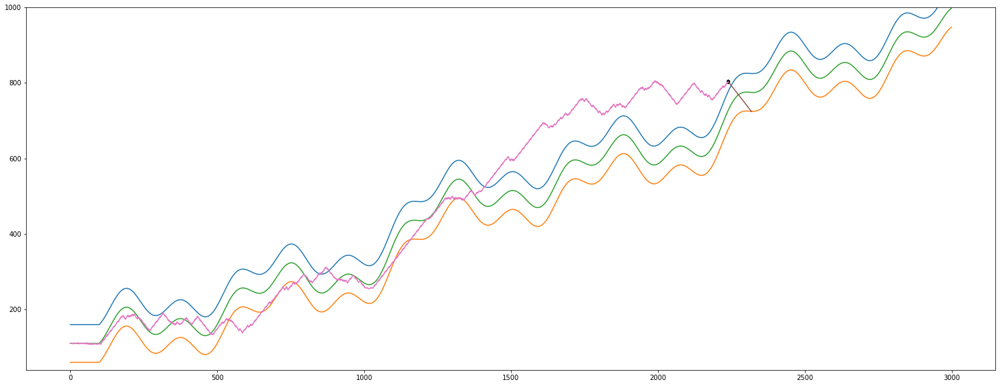

 --- plot --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  2240
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  1
Sensor from left wall =  1
Sensor from right wall =  79
most távolsagra van a felső faltól =  23.39681281668277
most távolsagra van az alsó faltól =  123.39681281668277
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2240
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  73.39681281668277
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  73.39681281668277
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2241
			 len(self.sensor_left)   =  2241
			 len(self.sensor_center) =  224

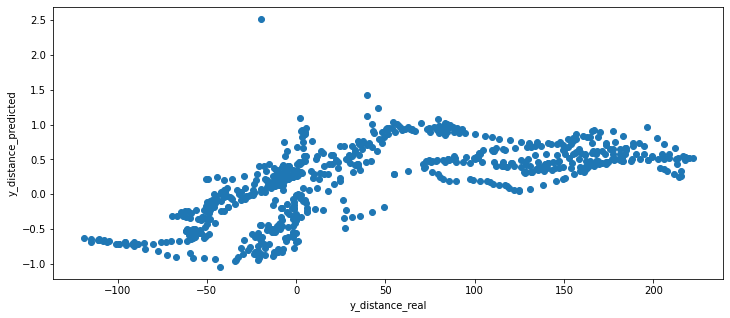

(2273, 1)
(2273, 1)


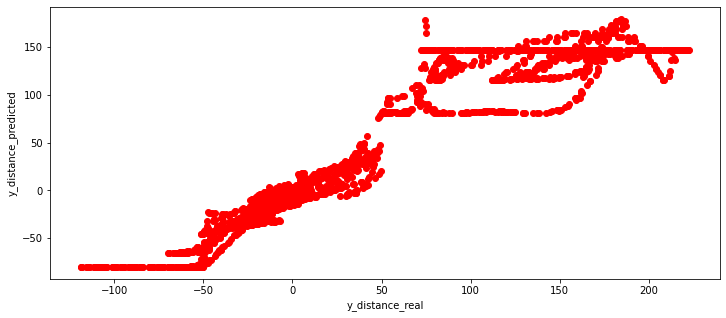

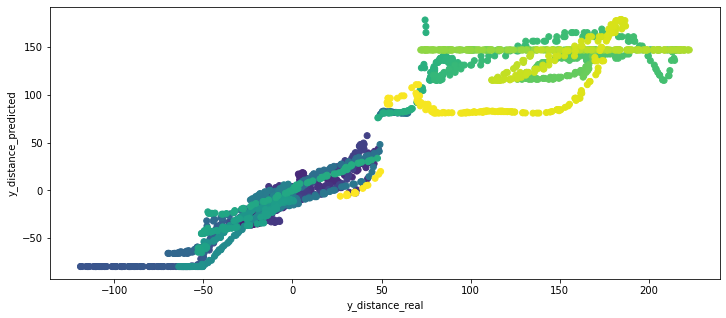

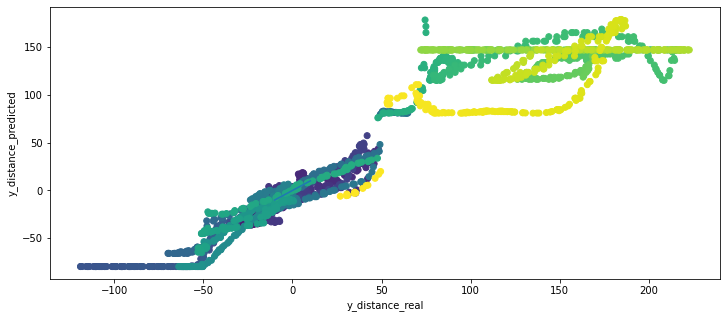

Streaming output truncated to the last 5000 lines.
Sensor from right wall =  72
most távolsagra van a felső faltól =  16.13440388461231
most távolsagra van az alsó faltól =  83.86559611538769
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2287
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  33.86559611538769
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  33.86559611538769
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2287
			 len(self.sensor_left)   =  2287
			 len(self.sensor_center) =  2287
			 len(self.sensor_right)  =  2287
			 self.x                  =  2287
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2288
			 len(self.sensor_left)

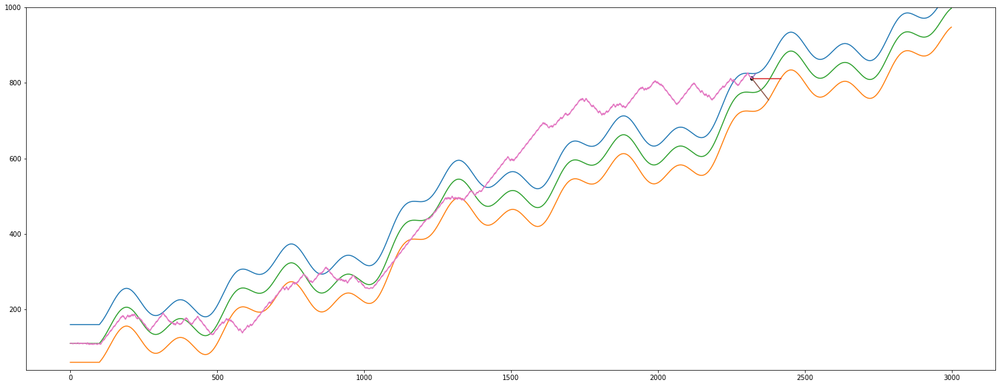

Streaming output truncated to the last 5000 lines.
			 len(self.y_distance)    =  2335
			 len(self.sensor_left)   =  2335
			 len(self.sensor_center) =  2335
			 len(self.sensor_right)  =  2335
			 self.x                  =  2334
			 -------------- Teszt End --------------
self.y új értéke   =  796.0
action             =  -3
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
796.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  1
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


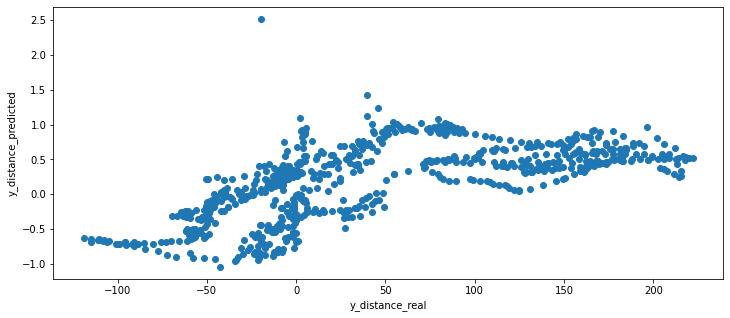

(2369, 1)
(2369, 1)


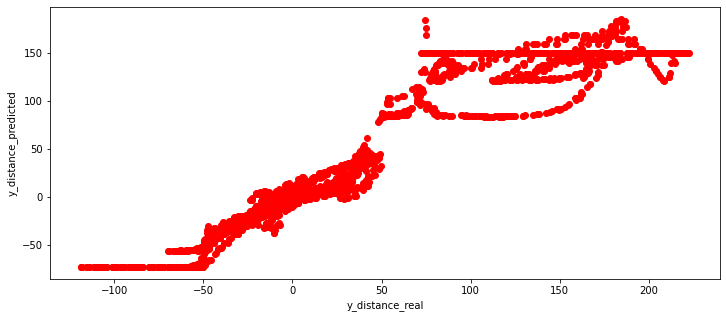

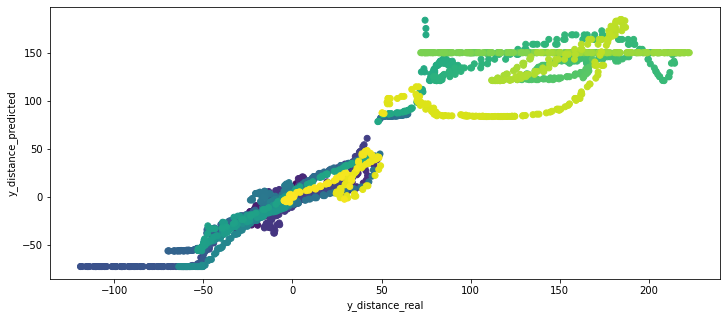

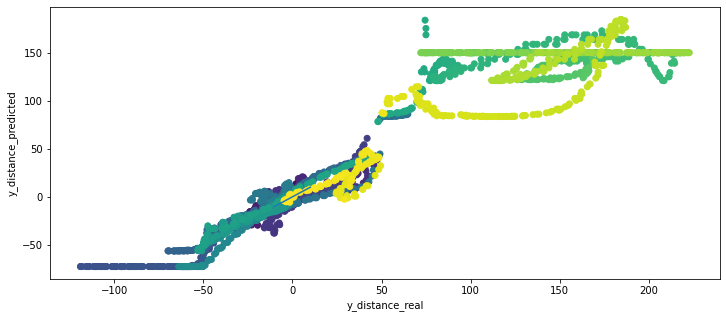

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
794.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  37
Sensor from left wall =  120
Sensor from right wall =  22
most távolsagra van a felső faltól =  52.60938490133583
most távolsagra van az alsó faltól =  47.39061509866417
cccc

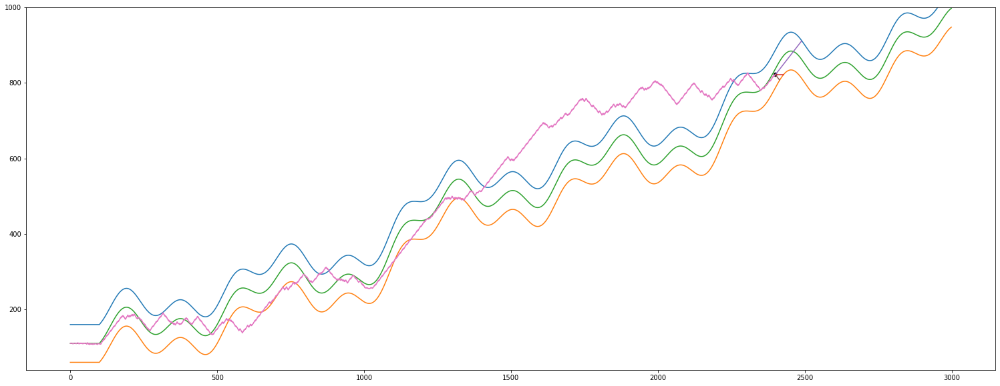

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_left)   =  2433
			 len(self.sensor_center) =  2433
			 len(self.sensor_right)  =  2433
			 self.x                  =  2433
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2434
			 len(self.sensor_left)   =  2434
			 len(self.sensor_center) =  2434
			 len(self.sensor_right)  =  2434
			 self.x                  =  2433
			 -------------- Append End --------------
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2433
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2434, 3)
y.shape =  (2434, 1)
i       =  2433
---------------------
X.max =  154
X.min =  1
X[:,0].max =  154
X[:,0].min =  1
X[:,1].max =  150
X[:,1].min =  1
X[:,2].max =  154
X[:,2].min =  1
y.max =  222.72143134182772
y.min =  -118.97255991743663
----------------

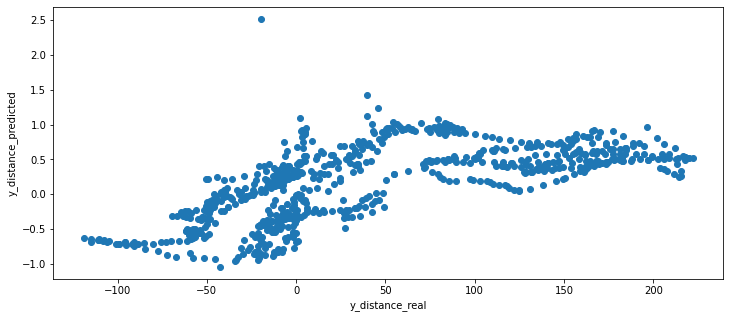

(2465, 1)
(2465, 1)


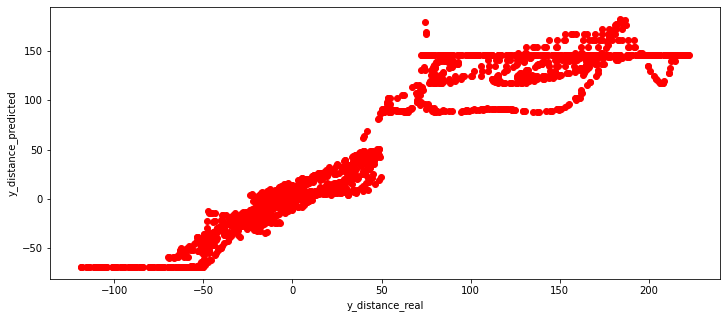

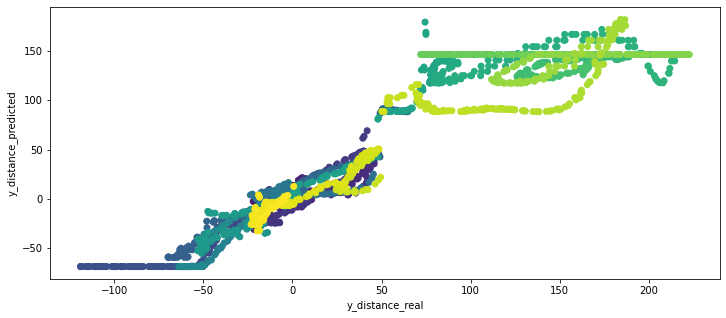

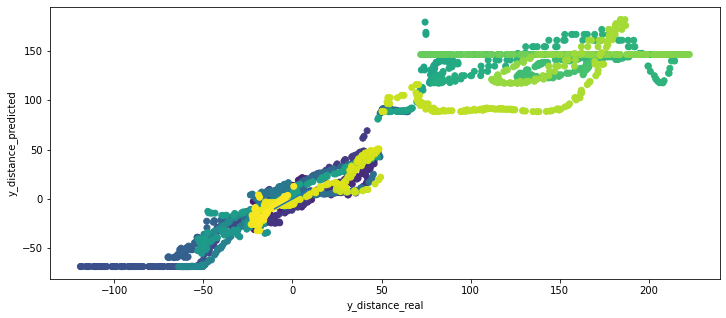

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
883.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  51
Sensor from left wall =  27
Sensor from right wall =  113
most távolsagra van a felső faltól =  48.85414050193856
most távolsagra van az alsó faltól =  51.14585949806144
cccc

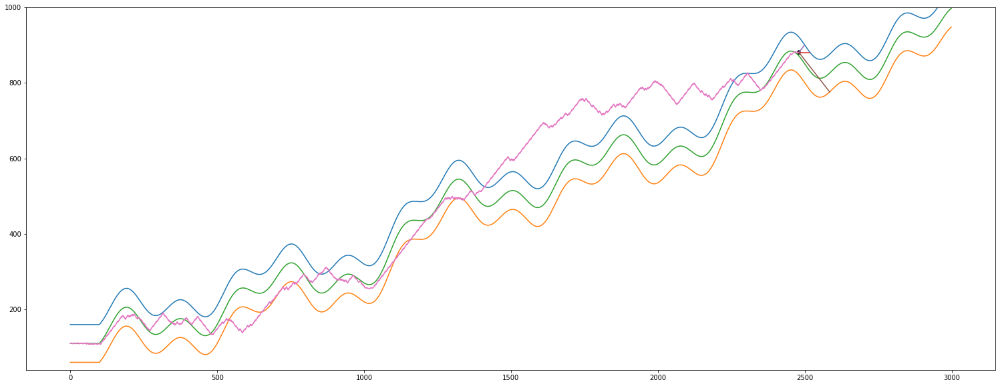

Streaming output truncated to the last 5000 lines.
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2527
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[  1   1 131]]
actual predicted =  [0.42577241]
actual self.y_distance[-1] =  105.21387156061735
len(self.y_distance_real)      =  836
len(self.y_distance_predicted) =  836
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
928.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++

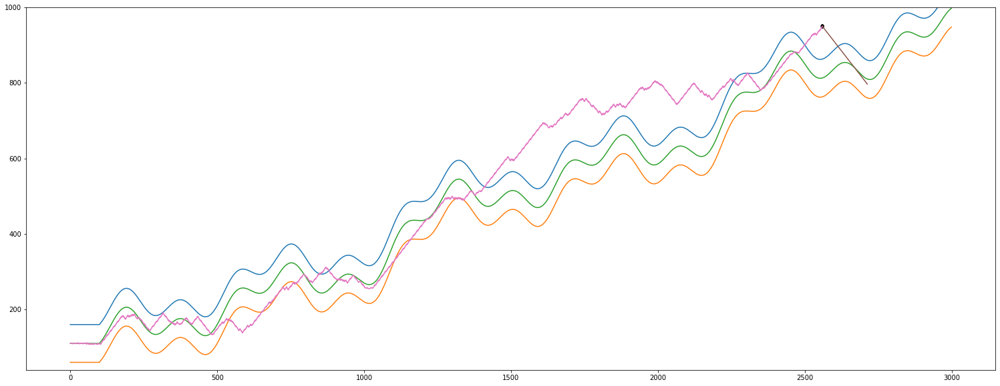

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2560
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[  1   1 154]]
actual predicted =  [0.53499171]
actual self.y_distance[-1] =  136.75049256363434
len(self.y_distance_real)      =  847
len(self.y_distance_predicted) =  847


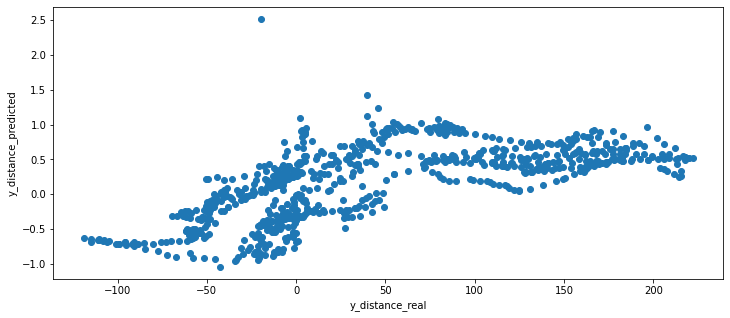

(2561, 1)
(2561, 1)


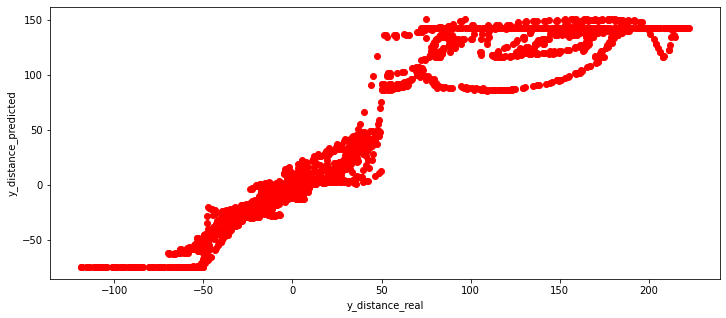

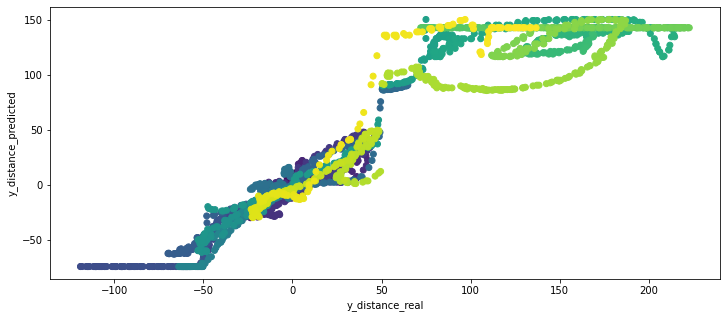

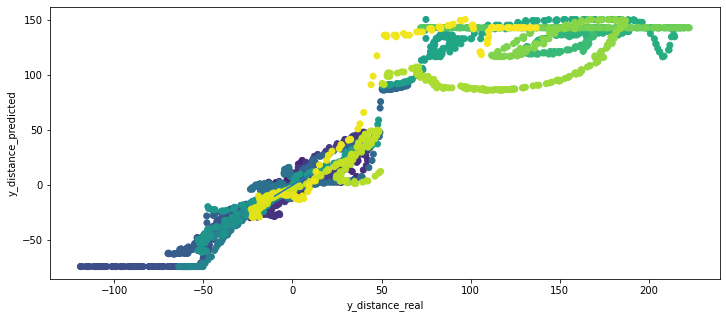

Streaming output truncated to the last 5000 lines.
# 			 _summary_mlp_fit_was_taken         =  1
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  1
Sensor from left wall =  1
most távolsagra van a felső faltól =  78.45629715935002
most távolsagra van az alsó faltól =  178.45629715935002
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2605
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  128.45629715935002
KKKKKKKKKKK

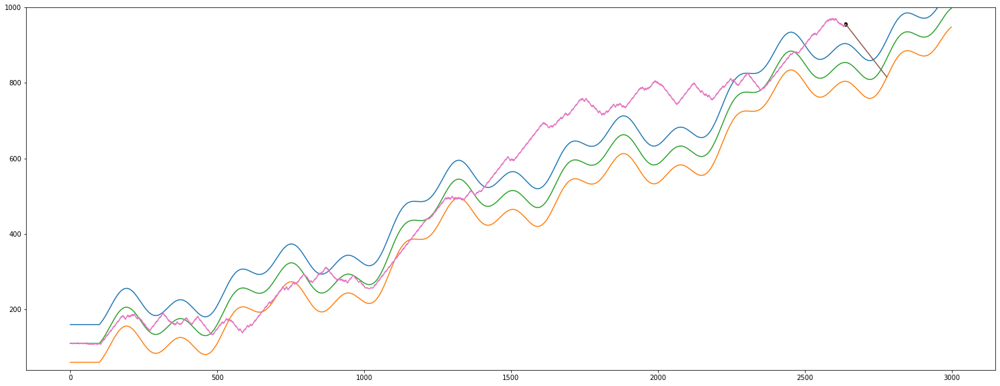

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2640
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2641, 3)
y.shape =  (2641, 1)
i       =  2640
---------------------
X.max =  154
X.min =  1
X[:,0].max =  154
X[:,0].min =  1
X[:,1].max =  150
X[:,1].min =  1
X[:,2].max =  154
X[:,2].min =  1
y.max =  222.72143134182772
y.min =  -118.97255991743663
---------------------
X_scaled.shape =  (2641, 3)
y_scaled.shape =  (2641, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2640
  Ha már van elég before after adatunk
# 3. Tanulás itt kerü

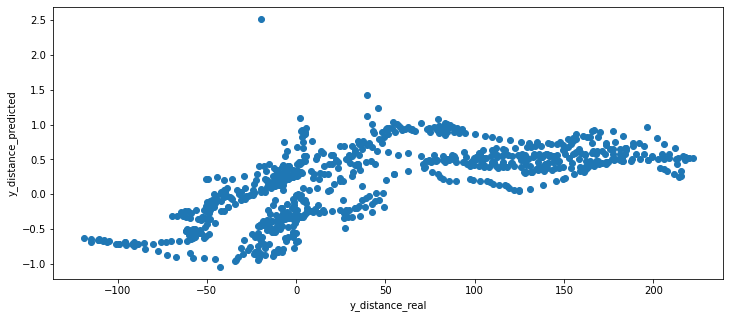

(2657, 1)
(2657, 1)


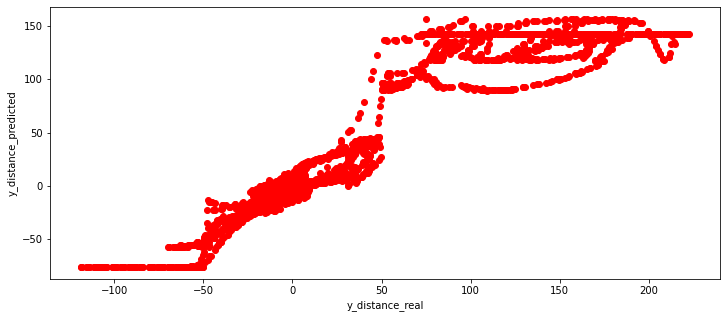

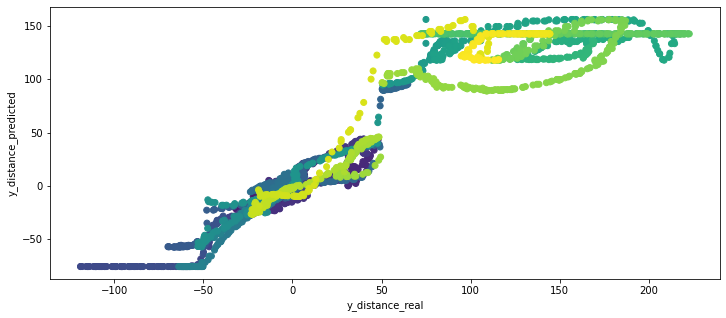

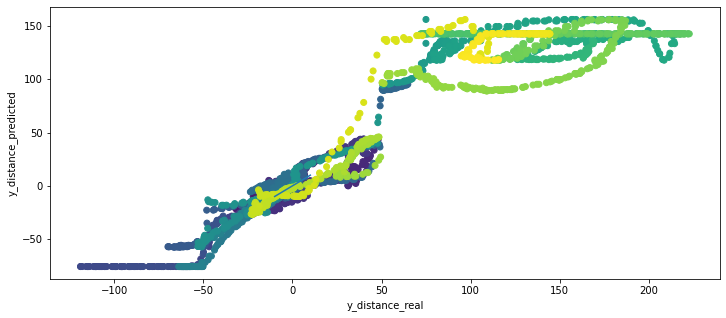

A streamkimeneten csak az utolsó 5000 sor látható.

		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[ 1 -3]]
		 _X_center =  [[ 1 -3]]
		 _X_right  =  [[128  -3]]
		 predicted_left   =  [[2.33027108]]
		 predicted_center =  [[-1.21066274]]
		 predicted_right  =  [[126.24907303]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.9985042  -0.44392229]]
		 regression_center.coef_ =  [[0.96452058 0.7250611 ]]
		 regression_right.coef_  =  [[0.99968081 0.57002349]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[  2.33027108  -1.21066274 126.24907303]]
		 ---------------Brutális

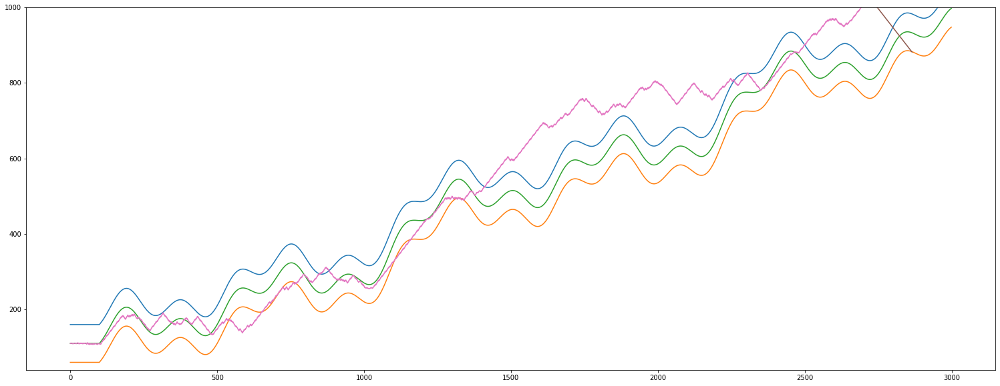

 --- plot --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  2720
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  1
Sensor from left wall =  1
Sensor from right wall =  144
most távolsagra van a felső faltól =  166.7743940022924
most távolsagra van az alsó faltól =  266.7743940022924
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2720
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  216.7743940022924
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  216.7743940022924
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2721
			 len(self.sensor_left)   =  2721
			 len(self.sensor_center) =  272

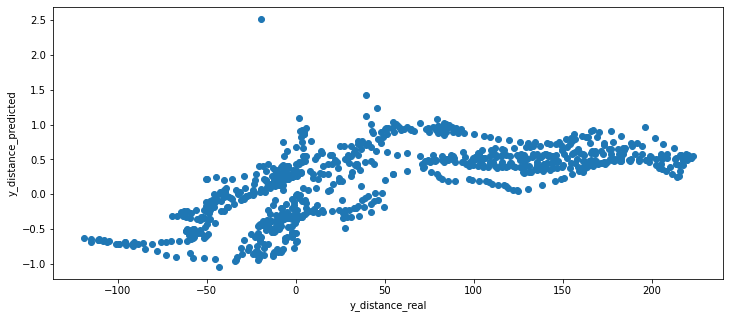

(2753, 1)
(2753, 1)


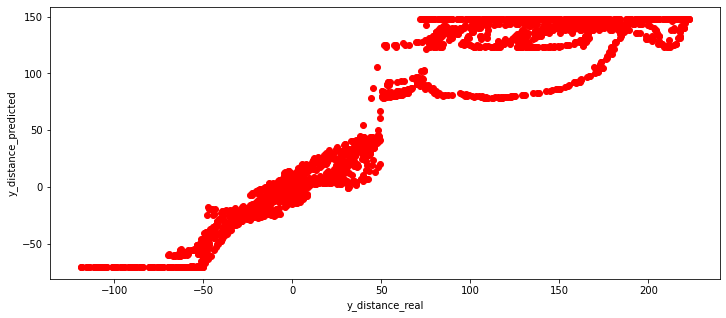

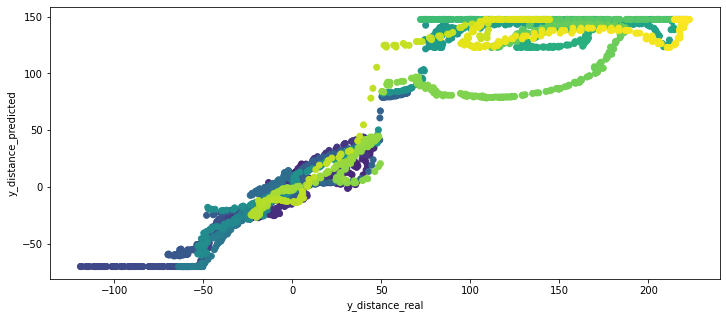

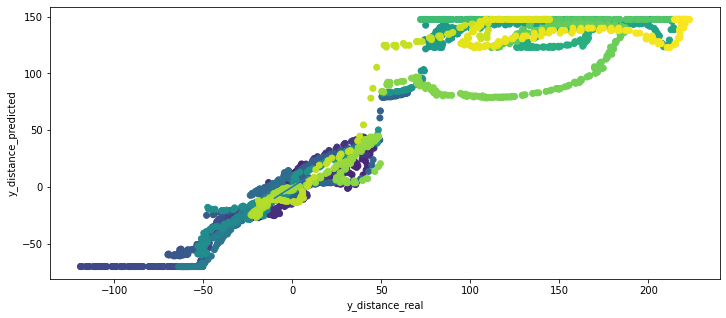

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
1043.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  1
Sensor from left wall =  1
most távolsagra van a felső faltól =  165.5323652249325
most távolsagra van az alsó faltól =  265.5323652249325
ccccccccccccccccccccccccccccccccccc

In [ ]:
auto.run()

<a name="irodalom"></a>

# Felhasznált irodalom és internetes cimek

Itt gyűjtöttem össze a menet közben összegyűjt okosságokat

[vissza a tartalomhoz](#tartalom)<br>

Scikit-learn - MLPRegressor API
<br>
https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html


Fogalmak és probléma meghatározás
<br>
https://www.rubrik.com/blog/architecture/20/12/customized-autoscaling--minimize-your-cloud-cost


https://github.com/kubernetes/autoscaler/blob/master/cluster-autoscaler/FAQ.md#what-are-the-parameters-to-ca

https://arxiv.org/pdf/1608.04030.pdf

Metrikák amivel a szollgáltatás minőségét mérik különböző esetekben
<br>
https://blog.avinetworks.com/autoscaling-metrics

------------

NumPy API Reference Guide
<br>
https://numpy.org/doc/stable/reference/random/generated/numpy.random.normal.html


Seaborn API Reference Guide
<br>
https://seaborn.pydata.org/examples/pair_grid_with_kde.html

